In [3]:
import anndata as ad
import matplotlib.pyplot as plt
import muon as mu
import pandas as pd
import scanpy as sc
import scirpy as ir
import numpy as np
import os

sc.set_figure_params(figsize=(4, 4))
sc.settings.verbosity = 2  # verbosity: errors (0), warnings (1), info (2), hints (3)
from matplotlib.ticker import FuncFormatter, PercentFormatter
ir.__version__
figPath = "figure-3.26"

AttributeError: module 'anndata' has no attribute '_core'

In [2]:
bcy_T = sc.read_h5ad("adata-T.h5ad")
bcm_T = sc.read_h5ad("bcm_T.h5ad")
preDict = ['1T','2T','3T','5N','5T','6N',
           '6T','8T','9T','10N','10T','12N','15T','16N',
           '17T','20T','21T','22T',
           ]
bcy_T = bcy_T[bcy_T.obs['batch'].isin(preDict), :]
common_vars = pd.unique(bcy_T.var_names.intersection(bcy_T.var_names))
bcy_T.obs['sample']=bcy_T.obs['batch']
bcy_T.obs['major-type']="T cells"
data_T = bcy_T[:, common_vars].concatenate(bcm_T, batch_categories=['Young', 'Middle'])
data_T.obs_names = [f"{s.split('-')[0]}-1-{s.split('-')[2]}" for s in data_T.obs_names]
data_T.obs_names_make_unique()

/home/rzh/BCY/lib/python3.10/site-packages/anndata/_core/anndata.py:1897: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/tmp/ipykernel_1615307/567808458.py:9: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  bcy_T.obs['sample']=bcy_T.obs['batch']
/tmp/ipykernel_1615307/567808458.py:11: FutureWarning: Use anndata.concat instead of AnnData.concatenate, AnnData.concatenate is deprecated and will be removed in the future. See the tutorial for concat at: https://anndata.readthedocs.io/en/latest/concatenation.html
  data_T = bcy_T[:, common_vars].concatenate(bcm_T, batch_categories=['Young', 'Middle'])
/home/rzh/BCY/lib/python3.10/site-packages/anndata/_core/anndata.py:1897: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/home/rzh/BCY/lib/python3.10/site-packages

In [ ]:
mdata_T = mu.read_h5mu("mdata-T1.h5mu")

NameError: name 'mu' is not defined

In [40]:
mdata_T.write_h5mu("mdata-T1.h5mu")

In [4]:
data_ir = mdata_T['airr'].copy()
data_ir = data_ir[data_ir.obs_names.isin(data_T.obs_names)]
mdata_T = mu.MuData({'gex': data_T, "airr":data_ir})
mdata_T

MuData object with n_obs × n_vars = 139864 × 19885
  2 modalities
    gex:	139864 x 19885
      obs:	'batch', 'mt_frac', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'n_genes', 'n_counts', 'leiden', 'major_type', 'molecular_type', 'leiden_harmony', 'major_type_harmony', 'leiden-T', 'T-type', 'T-subtype', 'sample', 'major-type', 'minor_type', 'minor-type', 'gender', 'doublet_score', 'predicted_doublet', 'leiden-harmony-female', 'majorType-Female', 'epi-subtype', 'majorType-fix', 'leiden-major', 'leiden-gex'
      var:	'n_cells_by_counts-Middle-Middle', 'mean_counts-Middle-Middle', 'log1p_mean_counts-Middle-Middle', 'pct_dropout_by_counts-Middle-Middle', 'total_counts-Middle-Middle', 'log1p_total_counts-Middle-Middle', 'n_cells-Middle-Middle', 'highly_variable-Middle-Middle', 'means-Middle-Middle', 'dispersions-Middle-Middle', 'dispersions_norm-Middle-Middle', 'ID-Middle-Middle', 'name-Middle-Middle', 'type-Middle-Middle', 'n_cells_by_counts-Young-Middle', 'mean_counts-Young-Middle', 'log1p_mean_counts-Young-Middle', 'pct_dropout_by_counts-Young-Middle', 'total_counts-Young-Middle', 'log1p_total_counts-Young-Middle', 'n_cells-Young-Middle', 'highly_variable-Young-Middle', 'means-Young-Middle', 'dispersions-Young-Middle', 'dispersions_norm-Young-Middle', 'n_cells_by_counts-Young', 'mean_counts-Young', 'log1p_mean_counts-Young', 'pct_dropout_by_counts-Young', 'total_counts-Young', 'log1p_total_counts-Young', 'n_cells-Young', 'highly_variable-Young', 'means-Young', 'dispersions-Young', 'dispersions_norm-Young'
      obsm:	'X_pca', 'X_pca_harmony', 'X_umap'
    airr:	46308 x 0
      obs:	'chain_pairing', 'clonal_expansion', 'clone_id', 'clone_id_size', 'clonotype_modularity', 'clonotype_modularity_fdr', 'receptor_subtype', 'receptor_type'
      uns:	'scirpy_version'
      obsm:	'airr'

In [5]:
def clu(adata, key_added, n_neighbors=50, n_pcs=30, rep='X_pca_harmony', do_har=False, max_iter=20, resolution=1, do_scrublet=True, har_key='batch'):
    # Computing the neighborhood graph
    if do_scrublet:
        n0 = adata.shape[0]
        print("{0} Cell number: {1}".format(key_added, n0))
        sc.external.pp.scrublet(adata, random_state=112)
        adata = adata[adata.obs['predicted_doublet']==False,:].copy()
        print("{0} Cells retained after scrublet, {1} cells reomved.".format(adata.shape[0], n0-adata.shape[0]))
    else:
        print("Ignoring processing doublet cells...")
    sc.tl.pca(adata, svd_solver='arpack')
    if do_har:
        sc.external.pp.harmony_integrate(adata, key='batch',max_iter_harmony=max_iter)
    sc.pp.neighbors(adata, n_neighbors=n_neighbors, n_pcs=n_pcs, use_rep=rep)
    # Run UMAP
    sc.tl.umap(adata)
    sc.tl.leiden(adata, key_added=key_added, resolution=resolution)
    sc.pl.umap(adata, color=key_added, legend_fontoutline=True, palette=sc.pl.palettes.default_20, legend_loc="on data")
    return adata

def marker(adata, groupby, method='wilcoxon', prefix=''):
    sc.tl.rank_genes_groups(adata, groupby = groupby, method = method)
    sc.tl.dendrogram(adata, groupby=groupby, use_rep='X_pca_harmony')
    sc.pl.rank_genes_groups_dotplot(adata, groupby = groupby, save=prefix+groupby+'.svg')
    return adata

Ignoring processing doublet cells...
computing PCA
    with n_comps=50
    finished (0:05:37)


2024-03-25 08:35:50,640 - harmonypy - INFO - Computing initial centroids with sklearn.KMeans...
2024-03-25 08:37:29,417 - harmonypy - INFO - sklearn.KMeans initialization complete.
2024-03-25 08:37:31,889 - harmonypy - INFO - Iteration 1 of 20
2024-03-25 08:38:54,345 - harmonypy - INFO - Iteration 2 of 20
2024-03-25 08:40:14,225 - harmonypy - INFO - Converged after 2 iterations


computing neighbors


/home/rzh/BCY/lib/python3.10/site-packages/numba/np/ufunc/parallel.py:371: NumbaWarning: The TBB threading layer requires TBB version 2021 update 6 or later i.e., TBB_INTERFACE_VERSION >= 12060. Found TBB_INTERFACE_VERSION = 12050. The TBB threading layer is disabled.
  warnings.warn(problem)


    finished (0:01:47)
computing UMAP
    finished (0:03:44)
running Leiden clustering
    finished (0:11:24)


/home/rzh/BCY/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


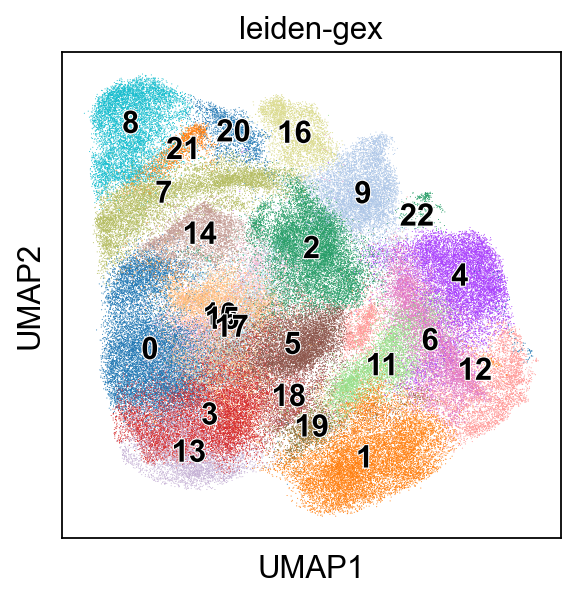

AnnData object with n_obs × n_vars = 139864 × 19885
    obs: 'batch', 'mt_frac', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'n_genes', 'n_counts', 'leiden', 'major_type', 'molecular_type', 'leiden_harmony', 'major_type_harmony', 'leiden-T', 'T-type', 'T-subtype', 'sample', 'major-type', 'minor_type', 'minor-type', 'gender', 'doublet_score', 'predicted_doublet', 'leiden-harmony-female', 'majorType-Female', 'epi-subtype', 'majorType-fix', 'leiden-major', 'leiden-gex'
    var: 'n_cells_by_counts-Middle-Middle', 'mean_counts-Middle-Middle', 'log1p_mean_counts-Middle-Middle', 'pct_dropout_by_counts-Middle-Middle', 'total_counts-Middle-Middle', 'log1p_total_counts-Middle-Middle', 'n_cells-Middle-Middle', 'highly_variable-Middle-Middle', 'means-Middle-Middle', 'dispersions-Middle-Middle', 'dispersions_norm-Middle-Middle', 'ID-Middle-Middle', 'name-Middle-Middle', 'type-Middle-Middle', 'n_cells_by_counts-Young-Middle', 'mean_counts-Young-Middle', 'log

In [6]:
clu(mdata_T['gex'], key_added="leiden-gex",do_har=True, do_scrublet=False)

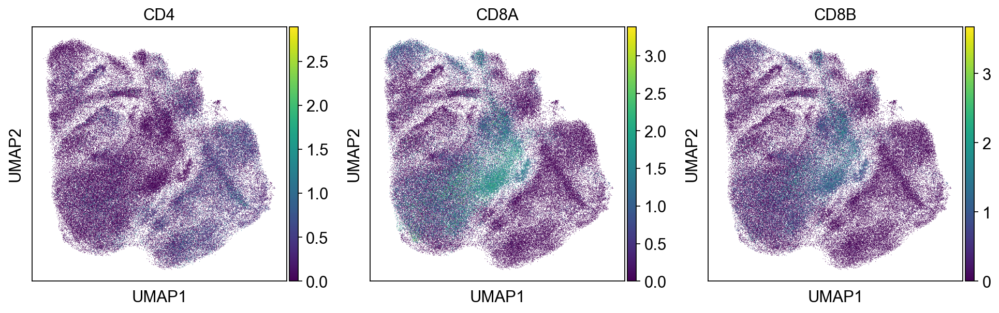

In [7]:
sc.pl.umap(mdata_T['gex'], color=["CD4", "CD8A", "CD8B"])

/home/rzh/BCY/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


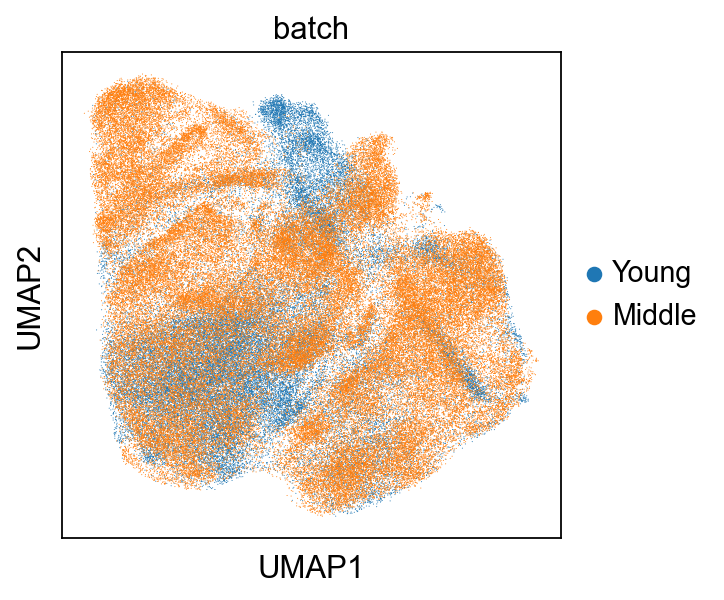

In [8]:
sc.pl.umap(mdata_T['gex'], color=["batch"])

ranking genes
    finished (0:08:19)
Storing dendrogram info using `.uns['dendrogram_leiden-gex']`


/home/rzh/BCY/lib/python3.10/site-packages/scanpy/tools/_rank_genes_groups.py:396: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.stats[group_name, 'names'] = self.var_names[global_indices]
/home/rzh/BCY/lib/python3.10/site-packages/scanpy/tools/_rank_genes_groups.py:398: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.stats[group_name, 'scores'] = scores[global_indices]
/home/rzh/BCY/lib/python3.10/site-packages/scanpy/tools/_rank_genes_groups.py:401: PerformanceWarning: DataFrame is highly fragmented.  This is usually t

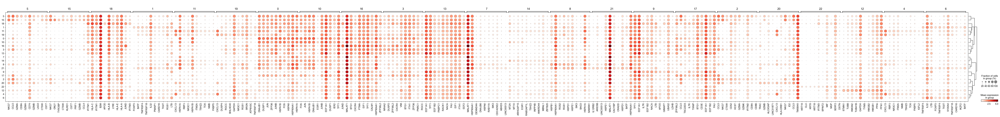

AnnData object with n_obs × n_vars = 139864 × 19885
    obs: 'batch', 'mt_frac', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'n_genes', 'n_counts', 'leiden', 'major_type', 'molecular_type', 'leiden_harmony', 'major_type_harmony', 'leiden-T', 'T-type', 'T-subtype', 'sample', 'major-type', 'minor_type', 'minor-type', 'gender', 'doublet_score', 'predicted_doublet', 'leiden-harmony-female', 'majorType-Female', 'epi-subtype', 'majorType-fix', 'leiden-major', 'leiden-gex'
    var: 'n_cells_by_counts-Middle-Middle', 'mean_counts-Middle-Middle', 'log1p_mean_counts-Middle-Middle', 'pct_dropout_by_counts-Middle-Middle', 'total_counts-Middle-Middle', 'log1p_total_counts-Middle-Middle', 'n_cells-Middle-Middle', 'highly_variable-Middle-Middle', 'means-Middle-Middle', 'dispersions-Middle-Middle', 'dispersions_norm-Middle-Middle', 'ID-Middle-Middle', 'name-Middle-Middle', 'type-Middle-Middle', 'n_cells_by_counts-Young-Middle', 'mean_counts-Young-Middle', 'log

In [9]:
marker(mdata_T['gex'], groupby="leiden-gex", prefix="tcr")

/home/rzh/BCY/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


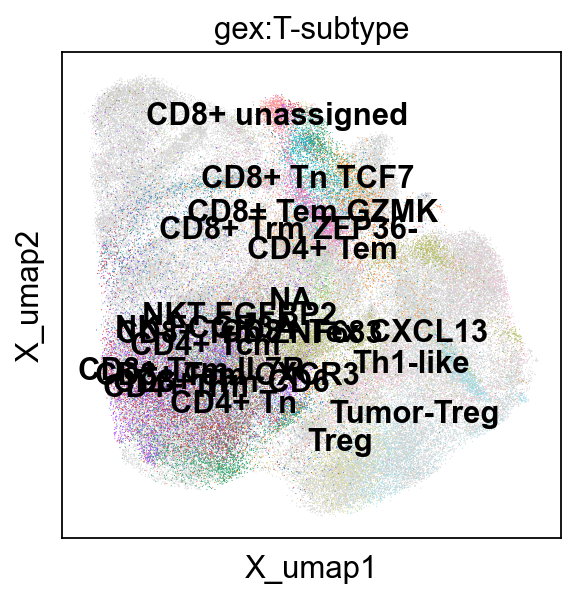

In [10]:
mdata_T['gex'].obs["T-subtype"] = bcy_T.obs['T-subtype']
mu.pl.embedding(mdata_T, basis="gex:umap", color="gex:T-subtype",legend_loc="on data")

/home/rzh/BCY/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


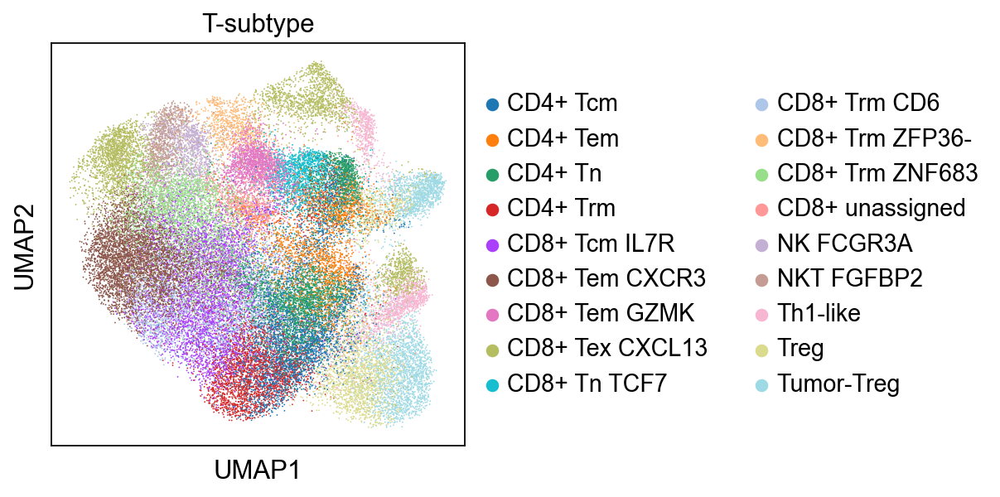

In [170]:
sc.pl.umap(adata_T, color="T-subtype")

Ignoring processing doublet cells...
computing PCA
    with n_comps=50
    finished (0:04:28)


2024-03-24 12:59:53,754 - harmonypy - INFO - Computing initial centroids with sklearn.KMeans...
2024-03-24 13:01:24,098 - harmonypy - INFO - sklearn.KMeans initialization complete.
2024-03-24 13:01:24,670 - harmonypy - INFO - Iteration 1 of 20
2024-03-24 13:02:05,144 - harmonypy - INFO - Iteration 2 of 20
2024-03-24 13:02:49,988 - harmonypy - INFO - Iteration 3 of 20
2024-03-24 13:03:09,780 - harmonypy - INFO - Converged after 3 iterations


computing neighbors


/home/rzh/BCY/lib/python3.10/site-packages/numba/np/ufunc/parallel.py:371: NumbaWarning: The TBB threading layer requires TBB version 2021 update 6 or later i.e., TBB_INTERFACE_VERSION >= 12060. Found TBB_INTERFACE_VERSION = 12050. The TBB threading layer is disabled.
  warnings.warn(problem)


    finished (0:01:26)
computing UMAP
    finished (0:02:16)
running Leiden clustering
    finished (0:06:15)


/home/rzh/BCY/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


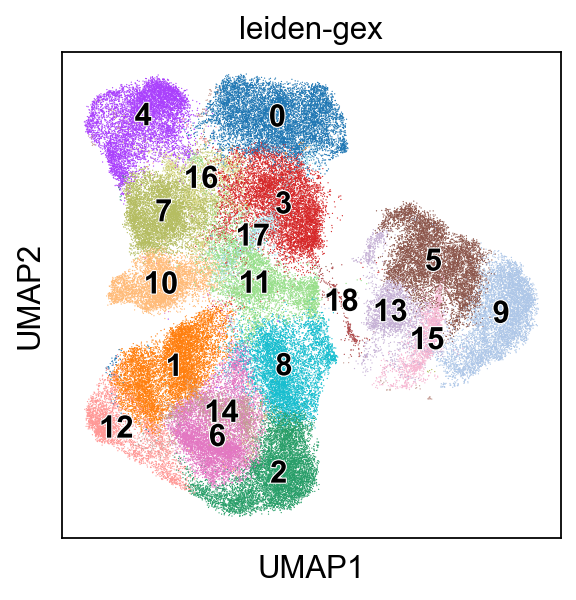

In [7]:
bcm_T = clu(bcm_T, key_added="leiden-gex",do_har=True, do_scrublet=False, har_key="sample")

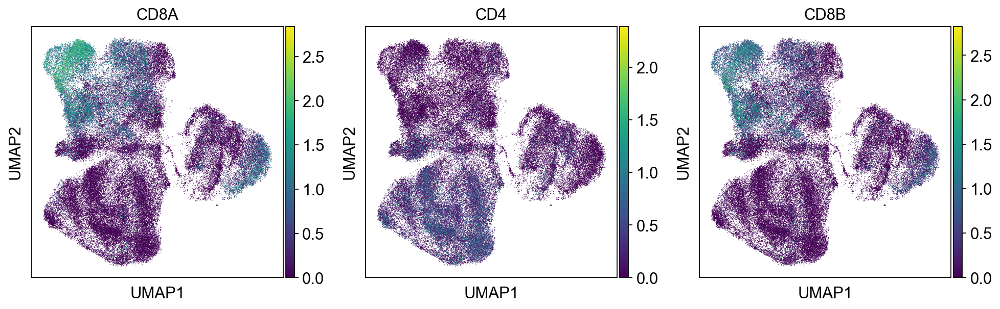

In [19]:
sc.pl.umap(bcm_T, color=["CD8A", 'CD4', 'CD8B'])

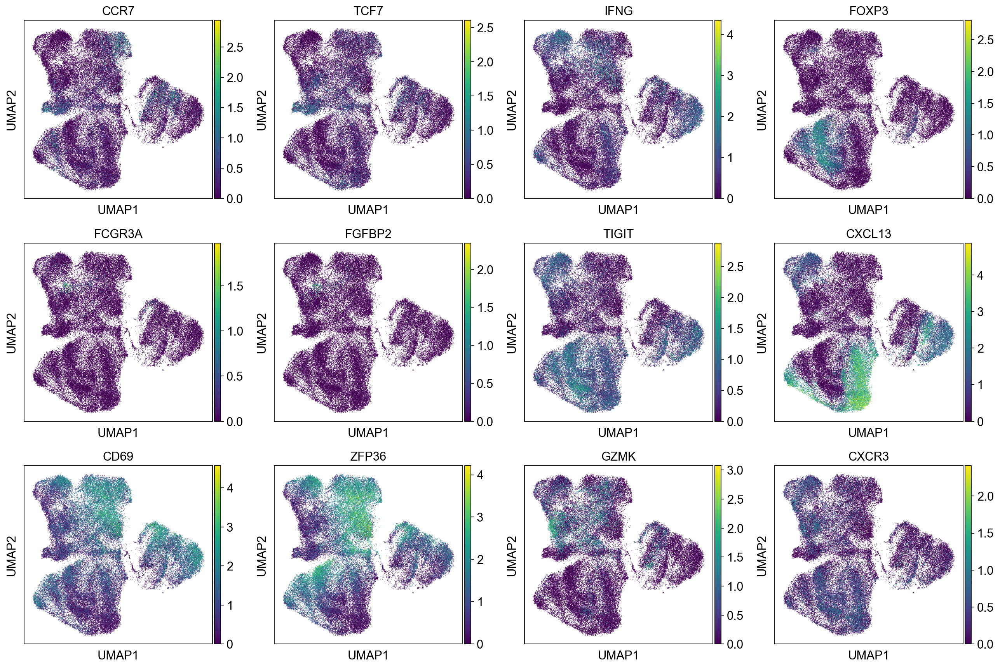

In [16]:
sc.pl.umap(bcm_T, color=["CCR7", 'TCF7', 'IFNG', 'FOXP3', 'FCGR3A', 'FGFBP2', 'TIGIT','CXCL13', "CD69", 'ZFP36', 'GZMK', 'CXCR3'])

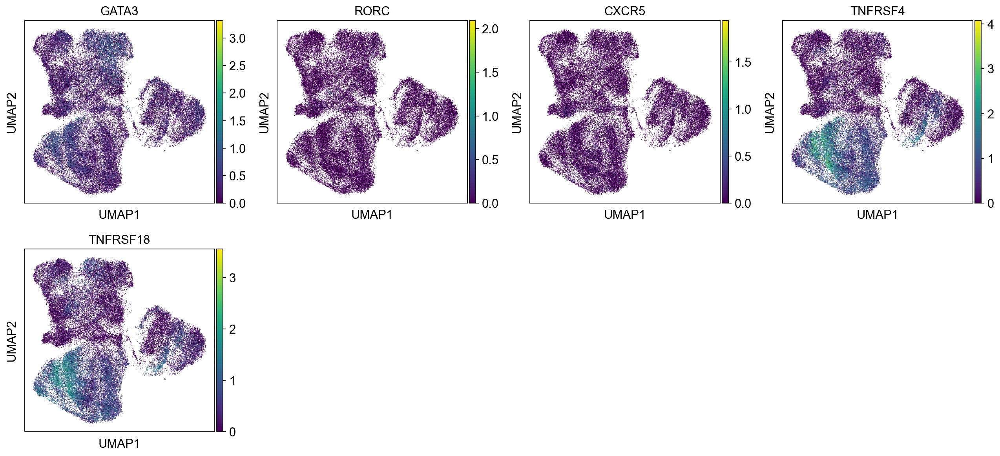

In [17]:
sc.pl.umap(bcm_T, color=["GATA3", 'RORC', 'CXCR5', 'TNFRSF4', 'TNFRSF18'])

In [10]:
bcm_T.obs_names = [f"{s.split('-')[0]}-1-{s.split('-')[2]}" for s in bcm_T.obs_names]

In [22]:
bcm_T.write_h5ad("bcm_T.h5ad")

In [192]:
data_preF.obs.loc[bcm_T.obs_names,'major-type']

AAACCTGAGGCTCAGA-1-HER2BC10-Middle    T cells
AAACCTGAGTTACCCA-1-HER2BC10-Middle    T cells
AAACCTGCAATGTTGC-1-HER2BC10-Middle    T cells
AAACCTGCAGTCACTA-1-HER2BC10-Middle    T cells
AAACCTGCATACAGCT-1-HER2BC10-Middle    T cells
                                       ...   
TTTGGTTTCCAGATCA-1-LABC8-3-Middle     T cells
TTTGTCAAGAGCCTAG-1-LABC8-1-Middle     T cells
TTTGTCAAGTAGATGT-1-LABC8-3-Middle     T cells
TTTGTCACACCCAGTG-1-LABC8-3-Middle     T cells
TTTGTCAGTTAGTGGG-1-LABC8-Middle       T cells
Name: major-type, Length: 93975, dtype: category
Categories (11, object): ['B cells', 'Basal Epi', 'Endothelial', 'Epithelial', ..., 'PeriVascular', 'Plasmablast', 'T & NK cells', 'T cells']

Filtering chains...
Indexing VJ chains...
Indexing VDJ chains...
build result array


/home/rzh/BCY/lib/python3.10/site-packages/scirpy/pp/_index_chains.py:142: ImplicitModificationWarning: Setting element `.obsm['chain_indices']` of view, initializing view as actual.
  params.adata.obsm[key_added] = ak.zip(res, depth_limit=1)  # type: ignore


Stored result in `mdata.obs["airr:receptor_type"]`.
Stored result in `mdata.obs["airr:receptor_subtype"]`.
Stored result in `mdata.obs["airr:chain_pairing"]`.


/home/rzh/BCY/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/rzh/BCY/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/rzh/BCY/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


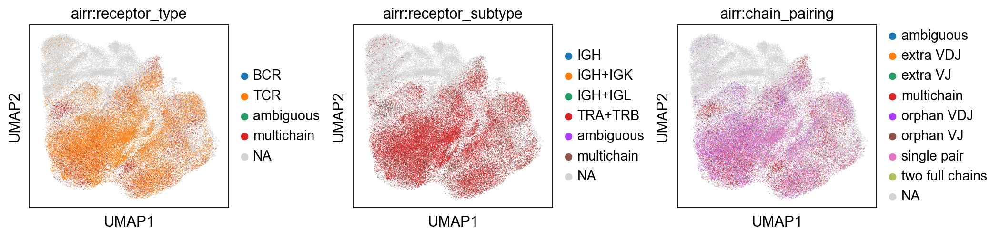

In [11]:
ir.pp.index_chains(mdata_T)
ir.tl.chain_qc(mdata_T)
# umap of TCR,BCR 
fig, ax = plt.subplots(1, 3,figsize=(13,3), constrained_layout=True)
for i,g in enumerate(["airr:receptor_type", "airr:receptor_subtype", 'airr:chain_pairing']):
  mu.pl.embedding(mdata_T, basis="gex:umap", color=g, ax=ax[i], show=False)
  ax[i].set_xlabel("UMAP1")
  ax[i].set_ylabel("UMAP2")
fig.savefig(f"{figPath}/T-umap-tcr.png", dpi=300, bbox_inches='tight')


In [42]:
print("Fraction of cells with more than one pair of TCRs: {:.2f}".format(
  np.sum(mdata_T.obs['airr:chain_pairing'].isin(["extraVJ", "extraVDJ", "two full chains"])) / mdata_T['airr'].n_obs
))

Fraction of cells with more than one pair of TCRs: 0.01


/home/rzh/BCY/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/rzh/BCY/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/rzh/BCY/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


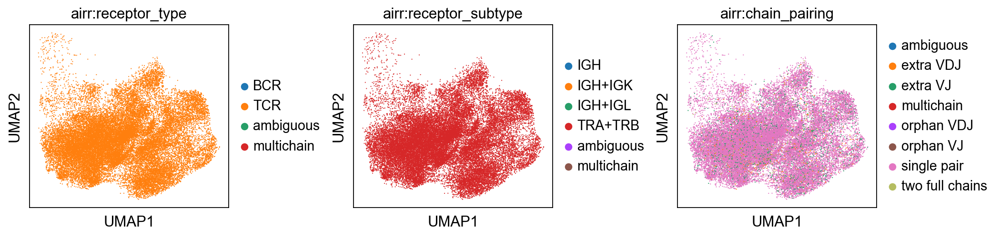

In [49]:
mu.pp.filter_obs(data=mdata_T, var="airr:receptor_type", func= lambda x: x == "TCR")
mu.pp.filter_obs(data=mdata_T, var="airr:receptor_subtype", func= lambda x: x == "TRA+TRB")
mu.pp.filter_obs(data=mdata_T, var="airr:chain_pairing", func= lambda x: ~np.isin(x,["orphan VDJ", 'orphan VJ']))
fig, ax = plt.subplots(1, 3,figsize=(13,3), constrained_layout=True)
for i,g in enumerate(["airr:receptor_type", "airr:receptor_subtype", 'airr:chain_pairing']):
  mu.pl.embedding(mdata_T, basis="gex:umap", color=g, ax=ax[i], show=False)
  ax[i].set_xlabel("UMAP1")
  ax[i].set_ylabel("UMAP2")
fig.savefig(f"{figPath}/T-umap-tcr1.png", dpi=300, bbox_inches='tight')

In [51]:
mdata_T.obs['airr:receptor_subtype']

AACACGTTCGAATCCA-1-5N       TRA+TRB
AACCATGTCGGTCTAA-1-5N       TRA+TRB
AACTCTTCAGATAATG-1-5N       TRA+TRB
AACTCTTTCCAGTAGT-1-5N       TRA+TRB
AACTCTTTCGGTGTCG-1-5N       TRA+TRB
                             ...   
TCATTTGCAGACAGGT-1-TNBC6    TRA+TRB
TCTGGAACACAGCCCA-1-TNBC6    TRA+TRB
TGAGAGGCAAGTTAAG-1-TNBC6    TRA+TRB
TGGCGCAAGGGTCGAT-1-TNBC6    TRA+TRB
TGGCGCAAGTCTCAAC-1-TNBC6    TRA+TRB
Name: airr:receptor_subtype, Length: 32831, dtype: category
Categories (6, object): ['IGH', 'IGH+IGK', 'IGH+IGL', 'TRA+TRB', 'ambiguous', 'multichain']

/home/rzh/BCY/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


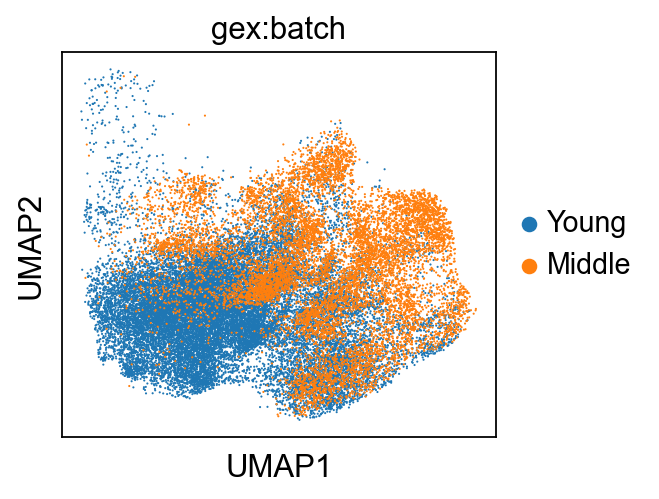

In [170]:
fig, ax = plt.subplots(1, 1,figsize=(4,3), constrained_layout=True)
mu.pl.embedding(mdata_T, basis="gex:umap", color="gex:batch", ax=ax, show=False)
ax.set_xlabel("UMAP1")
ax.set_ylabel("UMAP2")
fig.savefig(f"{figPath}/T-umap-batch.png", dpi=300, bbox_inches='tight')


In [13]:
mdata_T['gex'].obs['molecular_type'] = list(mdata_T['gex'].obs['molecular_type'])
mdata_T['gex'].obs.loc[mdata_T['gex'].obs['molecular_type'] == "HER2BC",'molecular_type'] = "HER2+"
mdata_T['gex'].obs.loc[mdata_T['gex'].obs['molecular_type'] == "LABC",'molecular_type'] = "Luminal A"

In [52]:
ir.pp.ir_dist(mdata_T, metric="identity", sequence="aa", key_added="ir_dist_aa_identity", n_jobs=16)
ir.tl.define_clonotypes(mdata_T, key_added="clone_id", same_v_gene=False, dual_ir='primary_only',receptor_arms="all" )
ir.tl.clonotype_network(mdata_T, min_cells=15)

Computing sequence x sequence distance matrix for VJ sequences.
Computing sequence x sequence distance matrix for VDJ sequences.
Initializing lookup tables. 
Computing clonotype x clonotype distances.
NB: Computation happens in chunks. The progressbar only advances when a chunk has finished. 


  0%|          | 0/19413 [00:00<?, ?it/s]

Stored result in `mdata.obs["airr:clone_id"]`.
Stored result in `mdata.obs["airr:clone_id_size"]`.


In [178]:
mdata_T.obs["airr:cc_aa_alignment"]

AACACGTTCGAATCCA-1-5N           0
AACCATGTCGGTCTAA-1-5N           1
AACTCTTCAGATAATG-1-5N           2
AACTCTTTCCAGTAGT-1-5N           3
AACTCTTTCGGTGTCG-1-5N           4
                            ...  
TCATTTGCAGACAGGT-1-TNBC6    18095
TCTGGAACACAGCCCA-1-TNBC6    18142
TGAGAGGCAAGTTAAG-1-TNBC6    17061
TGGCGCAAGGGTCGAT-1-TNBC6    18238
TGGCGCAAGTCTCAAC-1-TNBC6    18239
Name: airr:cc_aa_alignment, Length: 32831, dtype: category
Categories (18369, object): ['0', '1', '2', '3', ..., '18365', '18366', '18367', '18368']

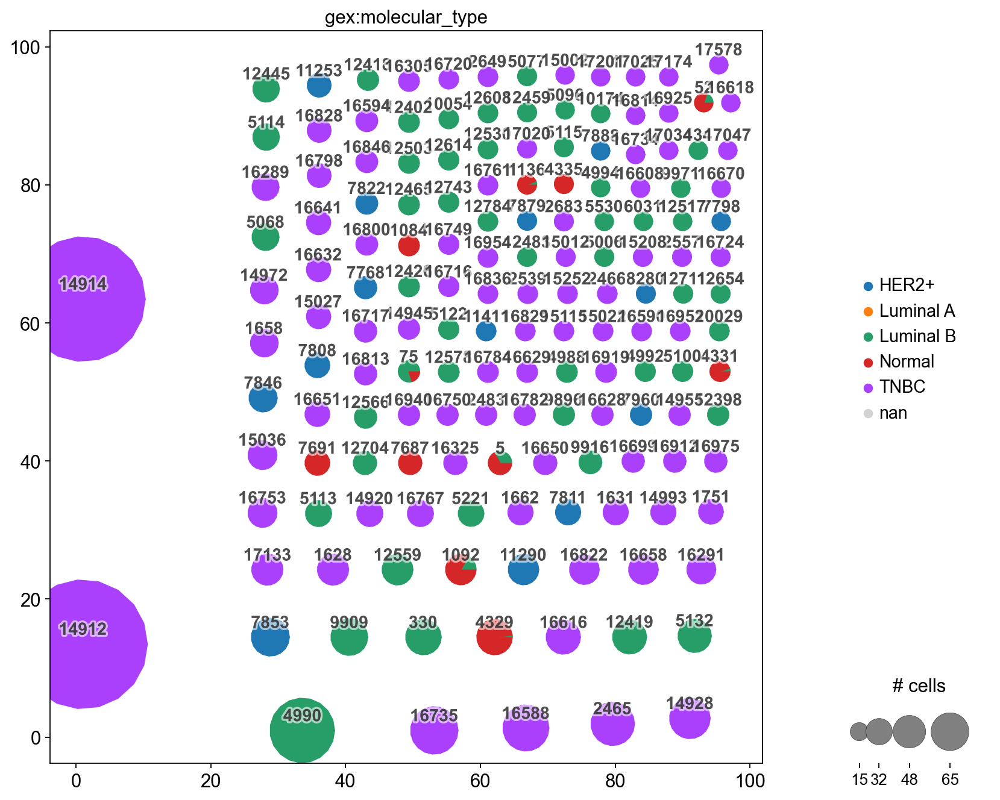

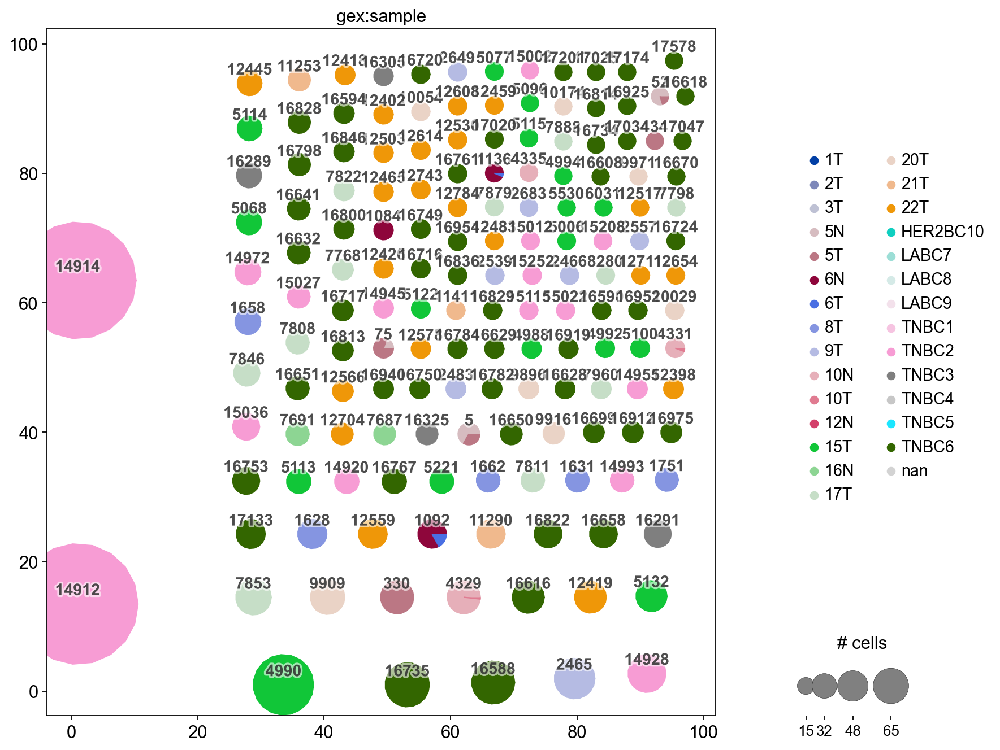

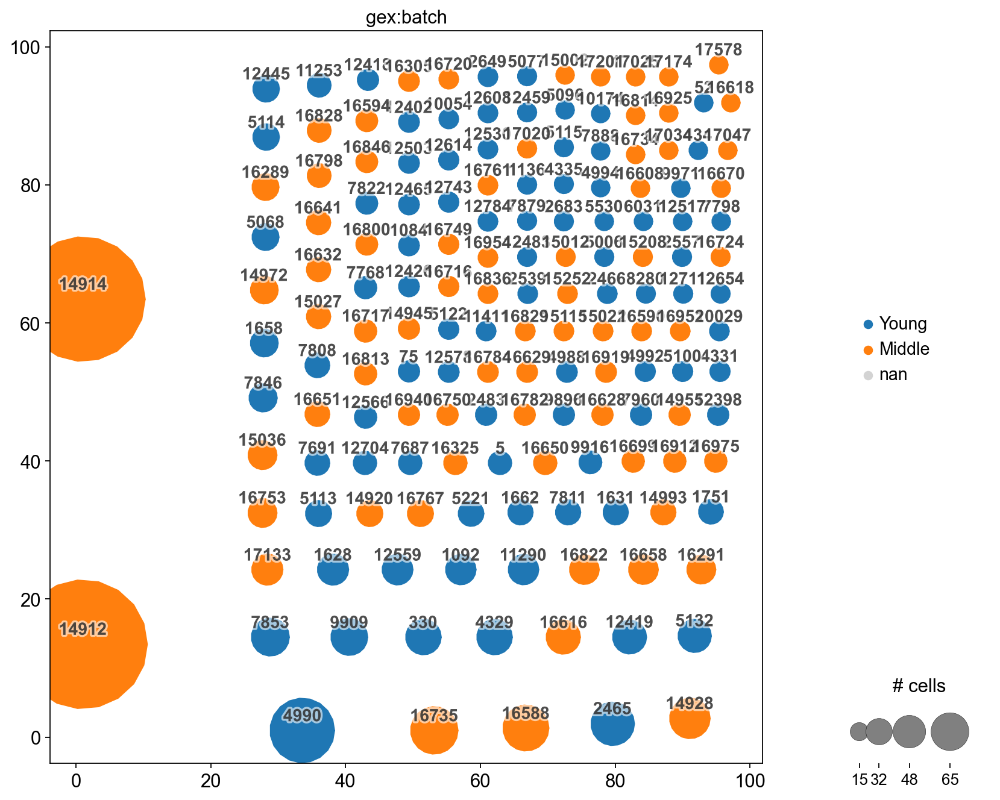

In [53]:
ir.pl.clonotype_network(mdata_T, color='gex:molecular_type').figure.savefig(f"{figPath}/clono_network_molecular_type.svg")
ir.pl.clonotype_network(mdata_T, color='gex:sample').figure.savefig(f"{figPath}/clono_network_sample.svg")
ir.pl.clonotype_network(mdata_T, color='gex:batch').figure.savefig(f"{figPath}/clono_network_batch.svg")


In [54]:
ir.pp.ir_dist(mdata_T, metric="alignment", sequence="aa", cutoff=15)
ir.tl.define_clonotype_clusters(mdata_T, sequence="aa", metric="alignment", receptor_arms="all", dual_ir="any")
ir.tl.clonotype_network(mdata_T, min_cells=10, sequence="aa", metric="alignment")

Computing sequence x sequence distance matrix for VJ sequences.
block size set to 606


/home/rzh/BCY/lib/python3.10/site-packages/setuptools_scm/_integration/setuptools.py:30: RuntimeWarning: 
ERROR: setuptools==59.6.0 is used in combination with setuptools_scm>=8.x

Your build configuration is incomplete and previously worked by accident!
setuptools_scm requires setuptools>=61

Suggested workaround if applicable:
 - migrating from the deprecated setup_requires mechanism to pep517/518
   and using a pyproject.toml to declare build dependencies
   which are reliably pre-installed before running the build tools

  warnings.warn(


  0%|          | 0/528 [00:00<?, ?it/s]

/home/rzh/BCY/lib/python3.10/site-packages/setuptools_scm/_integration/setuptools.py:30: RuntimeWarning: 
ERROR: setuptools==59.6.0 is used in combination with setuptools_scm>=8.x

Your build configuration is incomplete and previously worked by accident!
setuptools_scm requires setuptools>=61

Suggested workaround if applicable:
 - migrating from the deprecated setup_requires mechanism to pep517/518
   and using a pyproject.toml to declare build dependencies
   which are reliably pre-installed before running the build tools

  warnings.warn(
/home/rzh/BCY/lib/python3.10/site-packages/setuptools_scm/_integration/setuptools.py:30: RuntimeWarning: 
ERROR: setuptools==59.6.0 is used in combination with setuptools_scm>=8.x

Your build configuration is incomplete and previously worked by accident!
setuptools_scm requires setuptools>=61

Suggested workaround if applicable:
 - migrating from the deprecated setup_requires mechanism to pep517/518
   and using a pyproject.toml to declare build de

Computing sequence x sequence distance matrix for VDJ sequences.
block size set to 611


  0%|          | 0/528 [00:00<?, ?it/s]

Initializing lookup tables. 
Computing clonotype x clonotype distances.
NB: Computation happens in chunks. The progressbar only advances when a chunk has finished. 


  0%|          | 0/19943 [00:00<?, ?it/s]

Stored result in `mdata.obs["airr:cc_aa_alignment"]`.
Stored result in `mdata.obs["airr:cc_aa_alignment_size"]`.


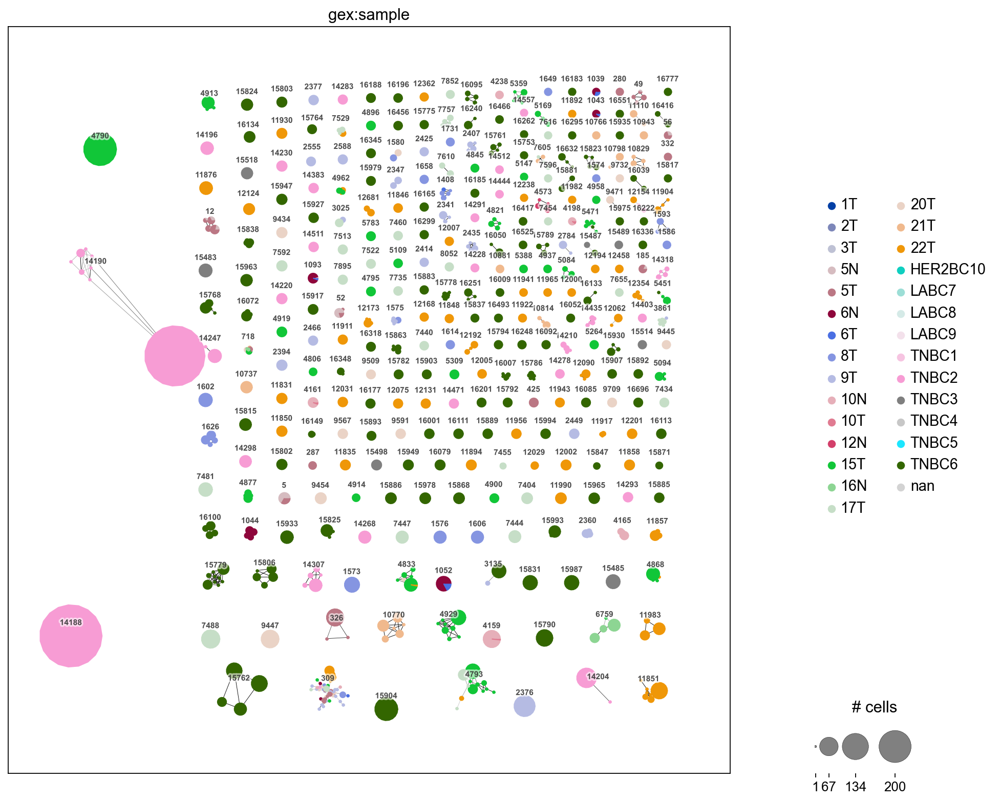

In [55]:
ir.pl.clonotype_network(mdata_T, color="gex:sample", label_fontsize=7, panel_size=(12,12), base_size=4).figure.savefig(f"{figPath}/clono_netcluster_sample.svg")

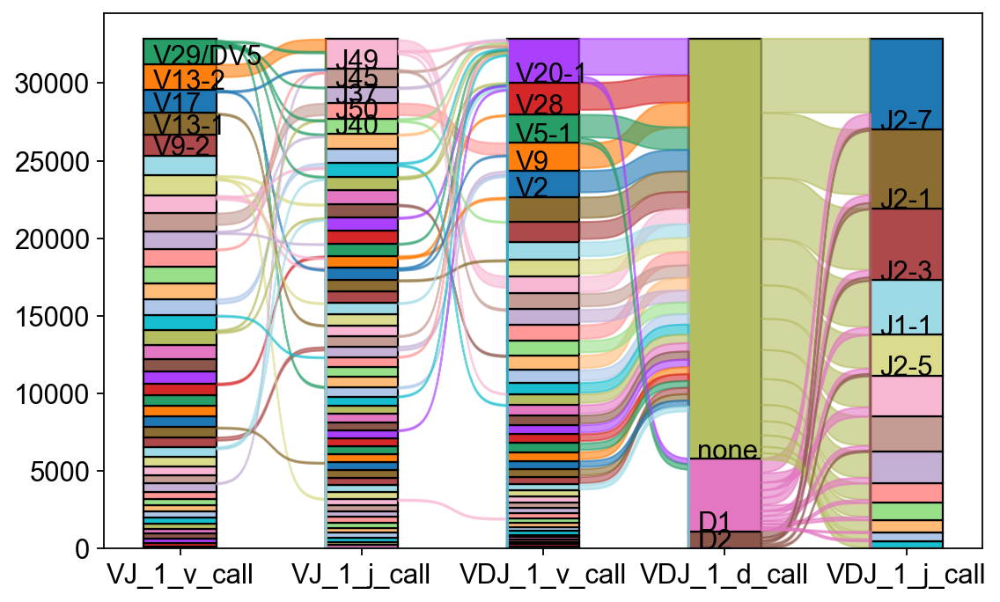

In [70]:
ir.pl.vdj_usage(
    mdata_T,
    full_combination=False,
    max_segments=None,
    max_ribbons=30,
    fig_kws={"figsize": (8, 5)},
).figure.savefig(f"{figPath}/sankey_all.png", dpi=300)

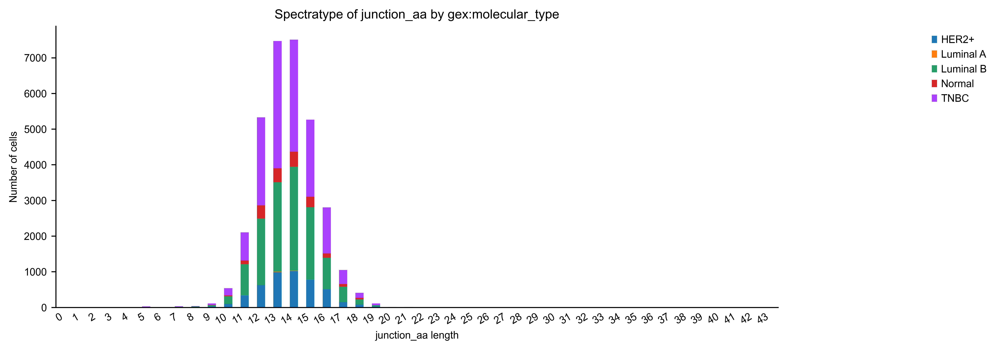

In [85]:
ir.pl.spectratype(
  mdata_T, 
  color="gex:molecular_type", 
  viztype="bar", 
  fig_kws={"dpi": 300, 
           "figsize": (10, 4)}
    ).figure.savefig(f"{figPath}/spectratype_molecular.png")

/home/rzh/BCY/lib/python3.10/site-packages/scirpy/pl/base.py:261: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_yticklabels(order)


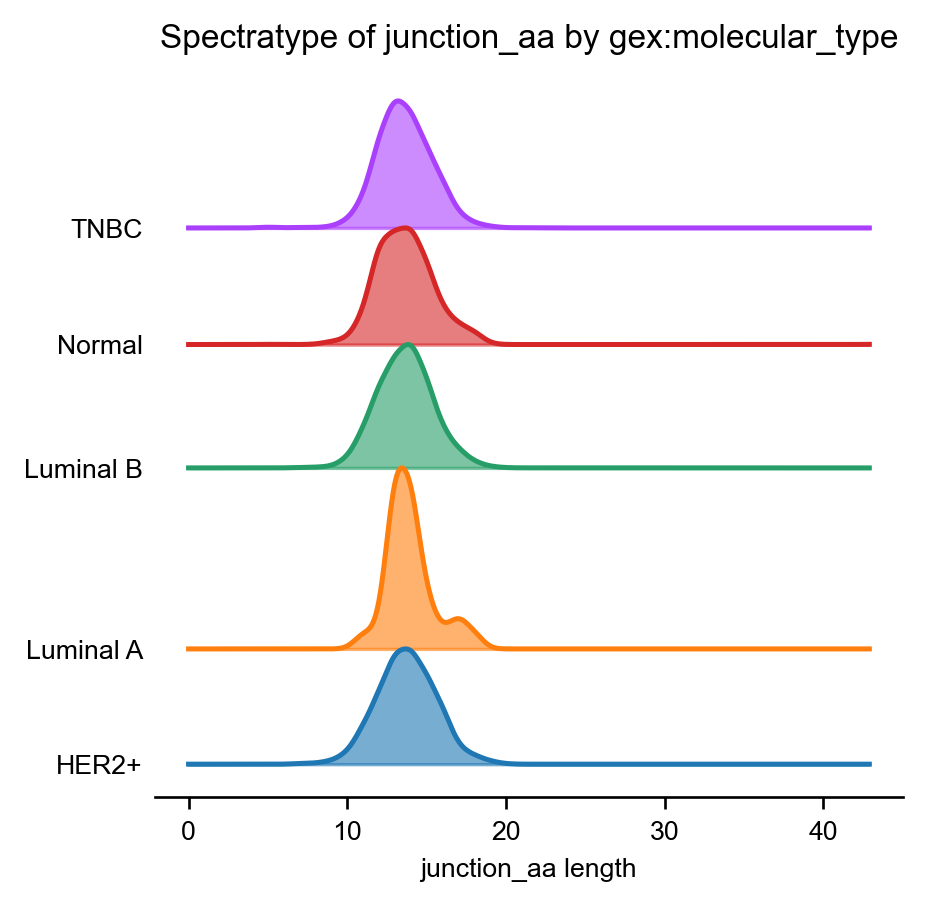

In [86]:
ir.pl.spectratype(
    mdata_T,
    color="gex:molecular_type",
    viztype="curve",
    curve_layout="shifted",
    fig_kws={"dpi": 120},
    kde_kws={"kde_norm": False},
    ).figure.savefig(f"{figPath}/spectratype_curve_molecular.png")

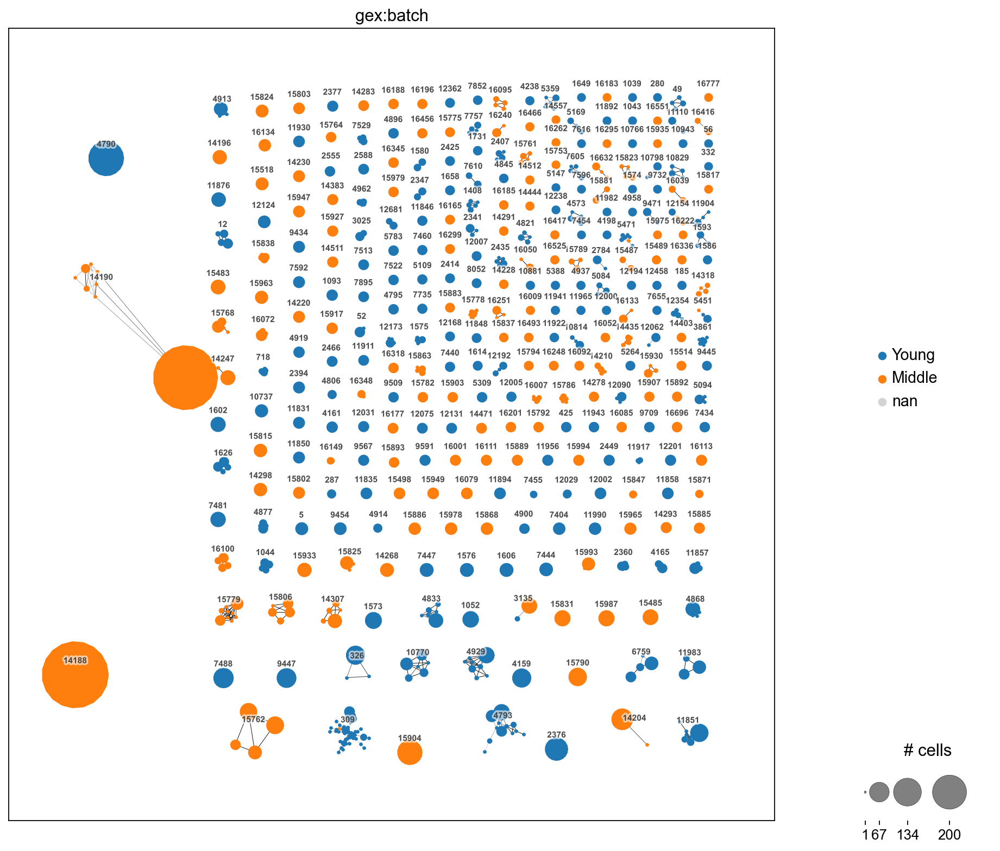

In [56]:
ir.pl.clonotype_network(mdata_T, color="gex:batch", label_fontsize=7, panel_size=(12,12), base_size=4).figure.savefig(f"{figPath}/clono_netcluster_batch.svg")

In [181]:
with ir.get.airr_context(mdata_T, "junction_aa", ["VJ_1", "VDJ_1", "VJ_2", "VDJ_2"]):
    cdr3_ct_309 = (
        # TODO astype(str) is required due to a bug in pandas ignoring `dropna=False`. It seems fixed in pandas 2.x
        mdata_T.obs.loc[lambda x: x["airr:cc_aa_alignment"] == "309"]
        .astype(str)
        .groupby(
            [
                "VJ_1_junction_aa",
                "VDJ_1_junction_aa",
                "VJ_2_junction_aa",
                "VDJ_2_junction_aa",
                "airr:receptor_subtype",
            ],
            observed=True,
            dropna=False,
        )
        .size()
        .reset_index(name="n_cells")
    )
cdr3_ct_309

,VJ_1_junction_aa,VDJ_1_junction_aa,VJ_2_junction_aa,VDJ_2_junction_aa,airr:receptor_subtype,n_cells
0,CAAMDSNYQLIW,CATSRGAGSTDTQYF,nan,nan,TRA+TRB,1
1,CAAQDSNYQLIW,CASSEVQGGTDTQYF,nan,nan,TRA+TRB,6
2,CAARMDSNYQLIW,CASSQDGAGTDTQYF,nan,nan,TRA+TRB,1
3,CAFLDSNYQLIW,CASSDSSGSADTQYF,nan,nan,TRA+TRB,1
4,CAGMDSNYQLIW,CASSDSSGSTDTQYF,nan,nan,TRA+TRB,2
5,CAGMDSNYQLIW,CASSDSTSGGADTQYF,nan,nan,TRA+TRB,1
6,CALISNFGNEKLTF,CASSHWTSGKTDTQYF,nan,nan,TRA+TRB,16
7,CASMDSNYQLIW,CASSDSSGGSTDTQYF,nan,nan,TRA+TRB,1
8,CAVAILTGGGNKLTF,CASSESLAGGPDTQYF,CAVMDSNYQLIW,nan,TRA+TRB,1
9,CAVEDSNYQLIW,CASSEETGGVETQYF,nan,nan,TRA+TRB,1


In [184]:
cdr3_ct_309['VDJ_1_junction_aa'].to_csv(f"{figPath}/cdr3_ct_309.csv", index=False)

In [58]:
with ir.get.airr_context(mdata_T, "junction_aa", ["VJ_1", "VDJ_1", "VJ_2", "VDJ_2"]):
    cdr3_ct_3135 = (
        # TODO astype(str) is required due to a bug in pandas ignoring `dropna=False`. It seems fixed in pandas 2.x
        mdata_T.obs.loc[lambda x: x["airr:cc_aa_alignment"] == "3135"]
        .astype(str)
        .groupby(
            [
                "VJ_1_junction_aa",
                "VDJ_1_junction_aa",
                "VJ_2_junction_aa",
                "VDJ_2_junction_aa",
                "airr:receptor_subtype",
            ],
            observed=True,
            dropna=False,
        )
        .size()
        .reset_index(name="n_cells")
    )
cdr3_ct_3135

,VJ_1_junction_aa,VDJ_1_junction_aa,VJ_2_junction_aa,VDJ_2_junction_aa,airr:receptor_subtype,n_cells
0,CATDADSGGGADGLTF,CASSTTGYYNEQFF,nan,nan,TRA+TRB,37
1,CATDPNSGGGADGLTF,CASSRTGYYNEQFF,nan,nan,TRA+TRB,3


In [70]:
ir.tl.define_clonotype_clusters(
    mdata_T,
    sequence="aa",
    metric="alignment",
    receptor_arms="all",
    dual_ir="any",
    same_v_gene=True,
    key_added="cc_aa_alignment_same_v",
)

Initializing lookup tables. 
Computing clonotype x clonotype distances.
NB: Computation happens in chunks. The progressbar only advances when a chunk has finished. 


  0%|          | 0/19950 [00:00<?, ?it/s]

Stored result in `mdata.obs["airr:cc_aa_alignment_same_v"]`.
Stored result in `mdata.obs["airr:cc_aa_alignment_same_v_size"]`.


In [72]:
# find clonotypes with more than one `clonotype_same_v`
ct_different_v = mdata_T.obs.groupby("airr:cc_aa_alignment").apply(
    lambda x: x["airr:cc_aa_alignment_same_v"].nunique() > 1
)
ct_different_v = ct_different_v[ct_different_v].index.values.tolist()
len(ct_different_v)

148

In [74]:
with ir.get.airr_context(mdata_T, "v_call", ["VJ_1", "VDJ_1"]):
    ct_different_v_df = (
        mdata_T.obs.loc[
            lambda x: x["airr:cc_aa_alignment"].isin(ct_different_v),
            [
                "airr:cc_aa_alignment",
                "airr:cc_aa_alignment_same_v",
                "VJ_1_v_call",
                "VDJ_1_v_call",
            ],
        ]
        .sort_values("airr:cc_aa_alignment")
        .drop_duplicates()
        .reset_index(drop=True)
    )
ct_different_v_df

,airr:cc_aa_alignment,airr:cc_aa_alignment_same_v,VJ_1_v_call,VDJ_1_v_call
0,10,10,TRAV1-2,TRBV4-3
1,10,3332,TRAV1-2,TRBV15
2,10,15844,TRAV1-2,TRBV19
3,10,5110,TRAV1-2,TRBV4-1
4,10,1773,TRAV1-2,TRBV4-3
...,...,...,...,...
373,16171,16339,TRAV13-1,TRBV5-1
374,16404,16573,TRAV8-3,TRBV11-2
375,16404,17145,TRAV8-3,TRBV7-2
376,16571,16743,TRAV5,TRBV4-3


Stored result in `mdata.obs["airr:clonal_expansion"]`.


/home/rzh/BCY/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


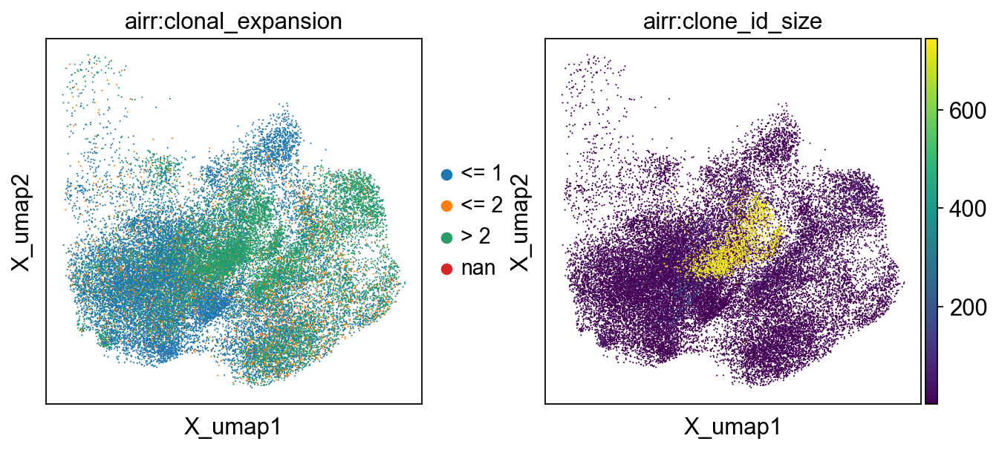

In [59]:
ir.tl.clonal_expansion(mdata_T)
mu.pl.embedding(mdata_T, basis="gex:umap", color=["airr:clonal_expansion", "airr:clone_id_size"])

<AxesSubplot: >

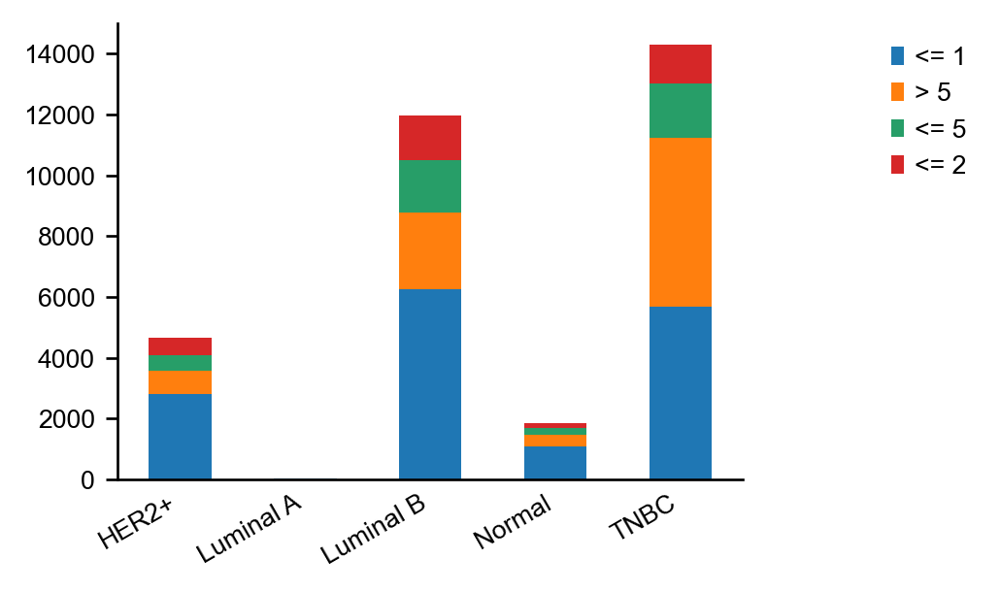

In [60]:
ir.pl.clonal_expansion(mdata_T, target_col="clone_id", groupby="gex:molecular_type", breakpoints=(1, 2, 5), normalize=False)

Stored result in `mdata.obs["airr:is_convergent"]`.


/home/rzh/BCY/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


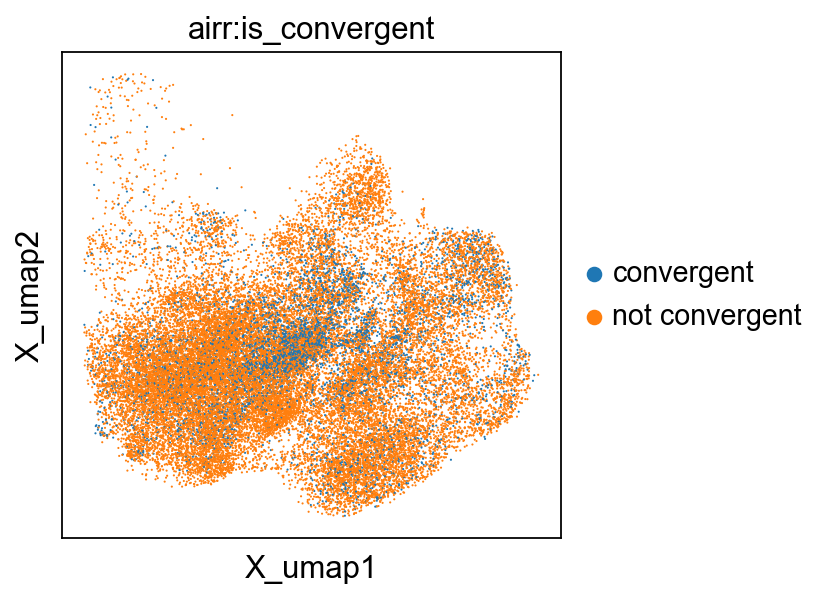

In [78]:
ir.tl.clonotype_convergence(mdata_T, key_coarse="cc_aa_alignment", key_fine="clone_id")
mu.pl.embedding(mdata_T, "gex:umap", color="airr:is_convergent")


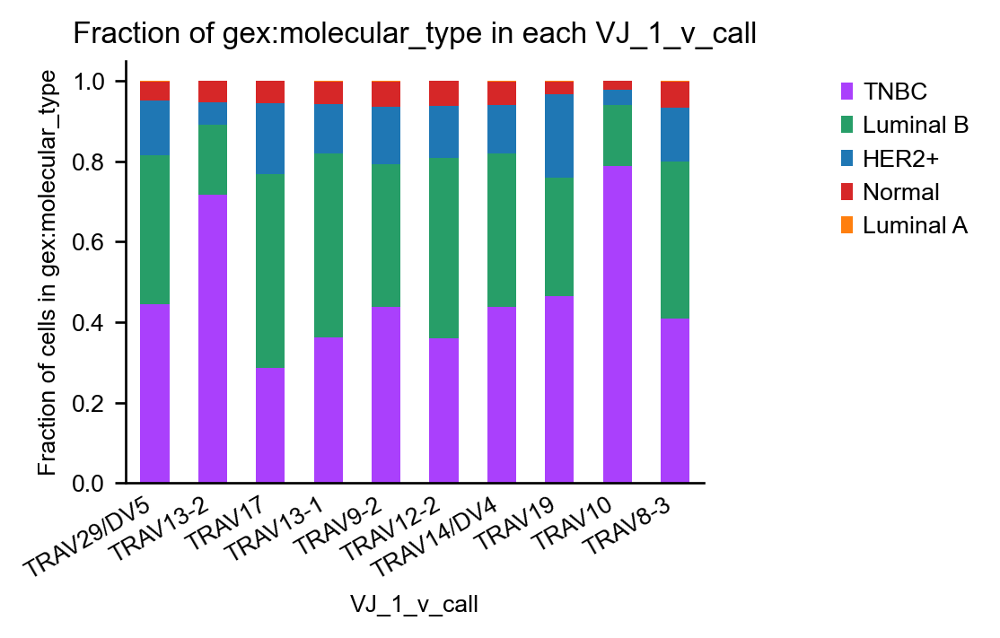

In [61]:
with ir.get.airr_context(mdata_T, "v_call"):
    ir.pl.group_abundance(
        mdata_T,
        groupby="VJ_1_v_call",
        target_col="gex:molecular_type",
        normalize=True,
        max_cols=10,
    )

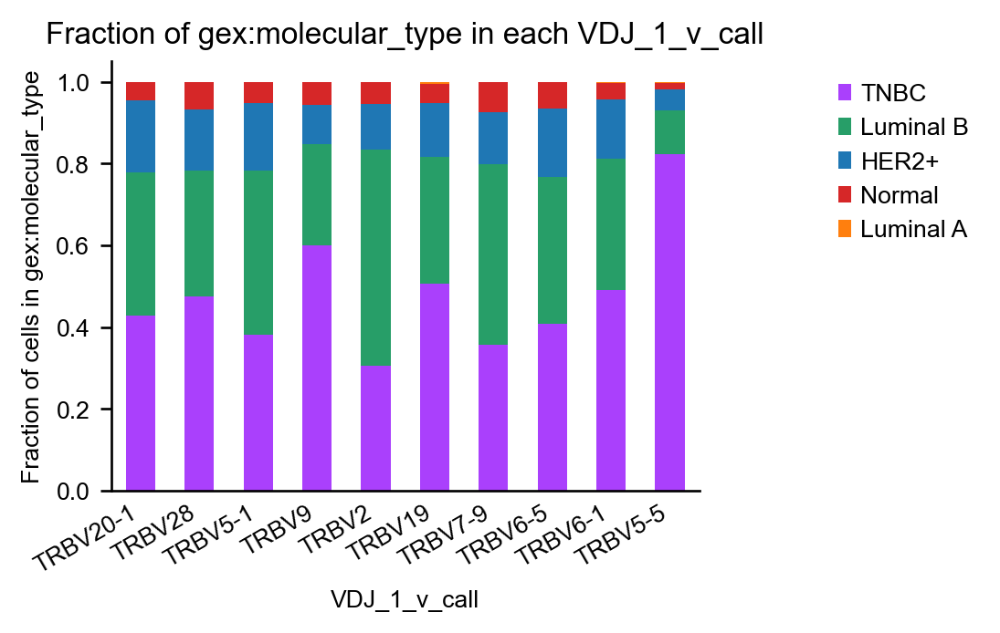

In [88]:
with ir.get.airr_context(mdata_T, "v_call"):
    ir.pl.group_abundance(
        mdata_T,
        groupby="VDJ_1_v_call",
        target_col="gex:molecular_type",
        normalize=True,
        max_cols=10,
    )

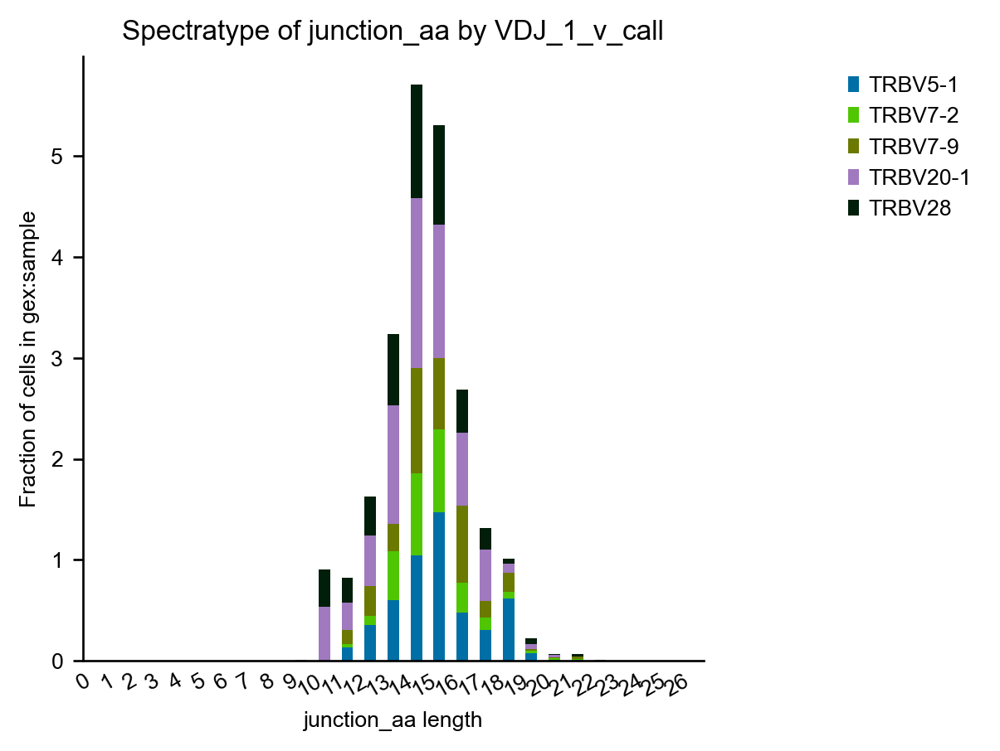

In [87]:
with ir.get.airr_context(mdata_T, "v_call"):
    ir.pl.spectratype(
        mdata_T[
            mdata_T.obs["VDJ_1_v_call"].isin(["TRBV20-1", "TRBV7-2", "TRBV28", "TRBV5-1", "TRBV7-9"]),
            :,
        ],
        chain="VDJ_1",
        color="VDJ_1_v_call",
        normalize="gex:sample",
        fig_kws={"dpi": 120},
    )

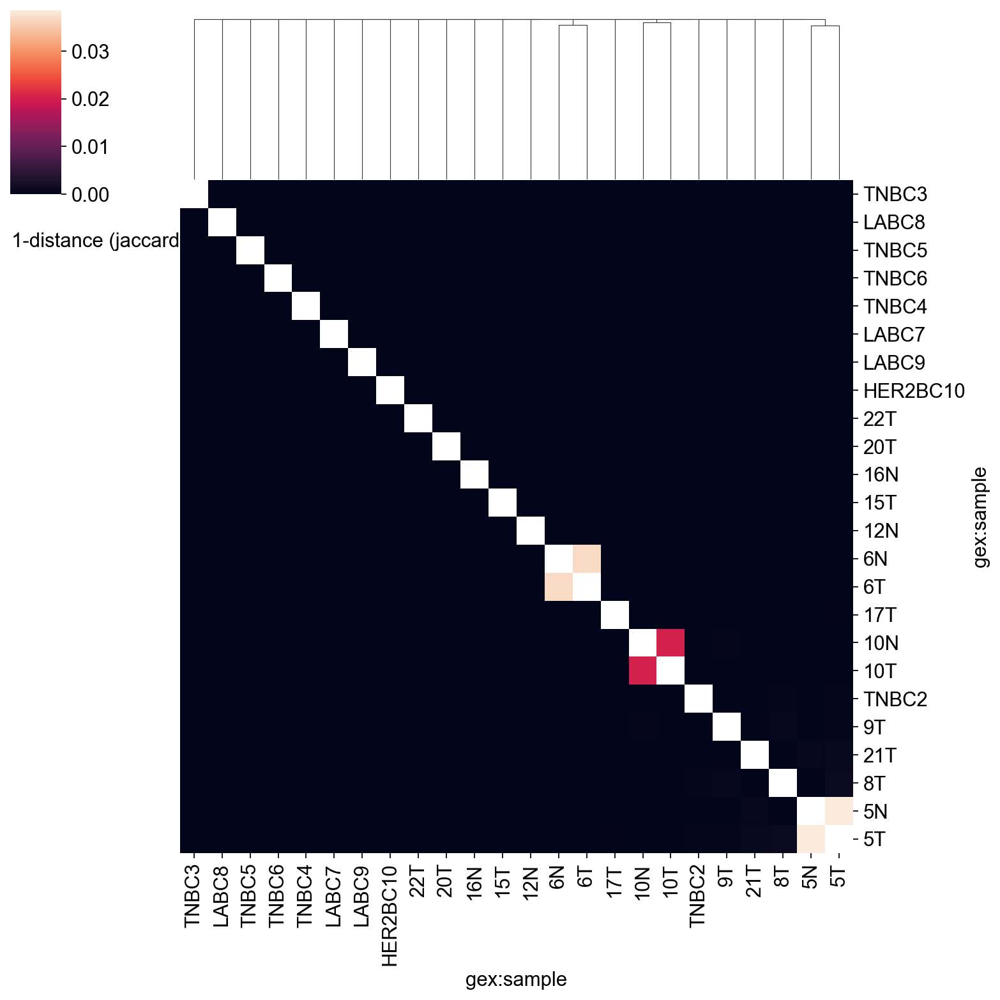

In [48]:
ir.tl.repertoire_overlap(mdata_T, groupby="gex:sample")
ir.pl.repertoire_overlap(mdata_T, groupby="gex:sample")

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


<AxesSubplot: title={'center': 'Repertoire overlap between 5N and 5T'}, xlabel='Clonotype size in 5N', ylabel='Clonotype size in 5T'>

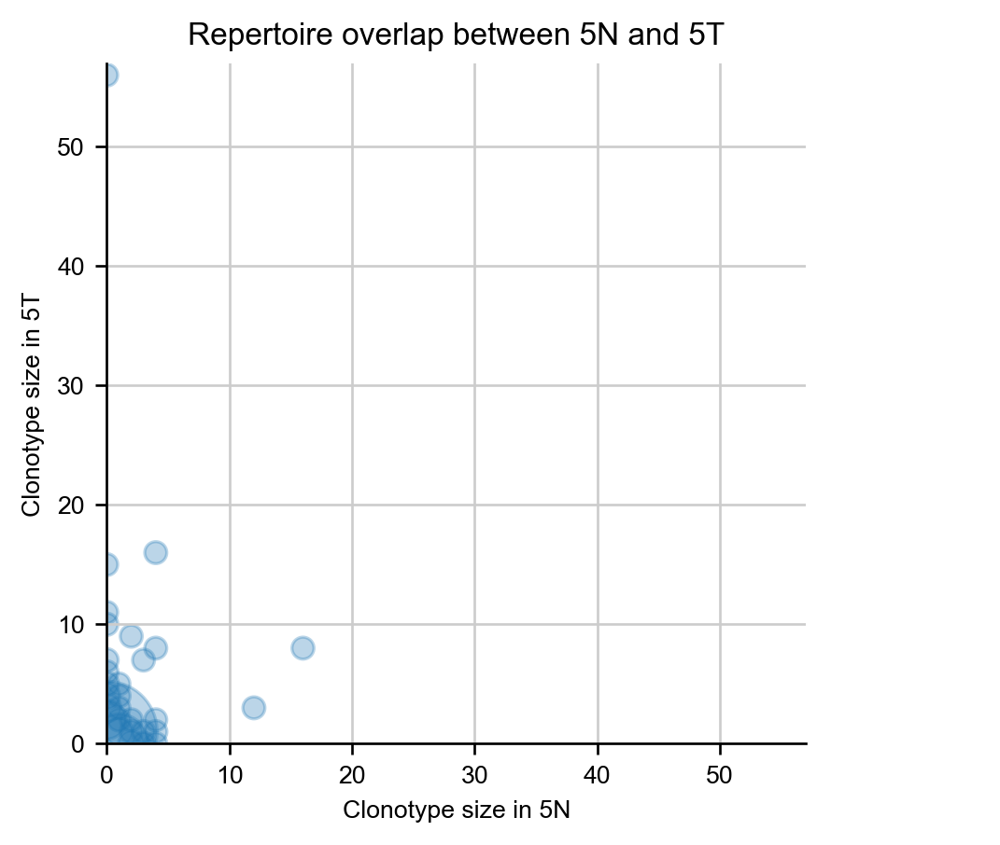

In [62]:
ir.pl.repertoire_overlap(mdata_T, "gex:sample", pair_to_plot=["5N", "5T"], fig_kws={"dpi": 120})

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


<AxesSubplot: title={'center': 'Repertoire overlap between 6N and 6T'}, xlabel='Clonotype size in 6N', ylabel='Clonotype size in 6T'>

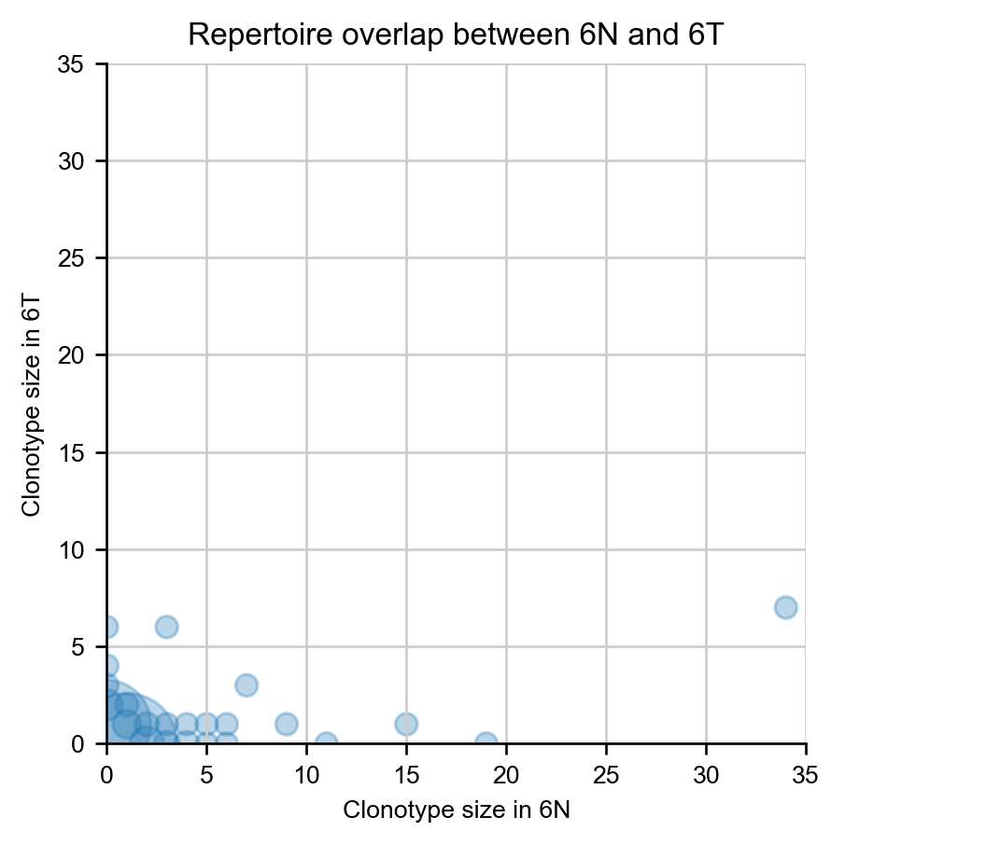

In [82]:
ir.pl.repertoire_overlap(mdata_T, "gex:sample", pair_to_plot=["6N", "6T"], fig_kws={"dpi": 120})

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


<AxesSubplot: title={'center': 'Repertoire overlap between 10N and 10T'}, xlabel='Clonotype size in 10N', ylabel='Clonotype size in 10T'>

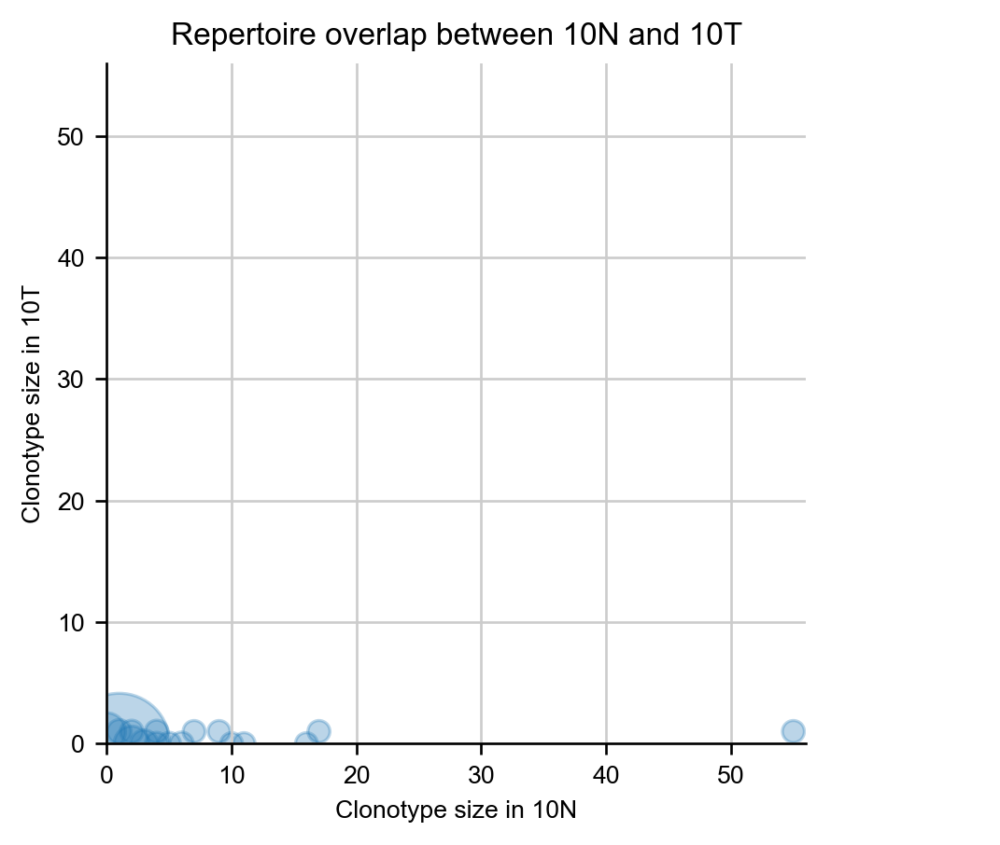

In [83]:
ir.pl.repertoire_overlap(mdata_T, "gex:sample", pair_to_plot=["10N", "10T"], fig_kws={"dpi": 120})

In [89]:
ir.tl.clonotype_modularity(mdata_T, target_col="airr:cc_aa_alignment")
ir.pl.clonotype_modularity(mdata_T)

Initalizing clonotype subgraphs...


  0%|          | 0/18369 [00:00<?, ?it/s]

Computing background distributions...


  0%|          | 0/1000 [00:00<?, ?it/s]

Stored result in `mdata.obs["airr:clonotype_modularity"]`.


/home/rzh/BCY/lib/python3.10/site-packages/scipy/optimize/_numdiff.py:576: RuntimeWarning: invalid value encountered in subtract
  df = fun(x) - f0


Stored result in `mdata.obs["airr:clonotype_modularity_fdr"]`.


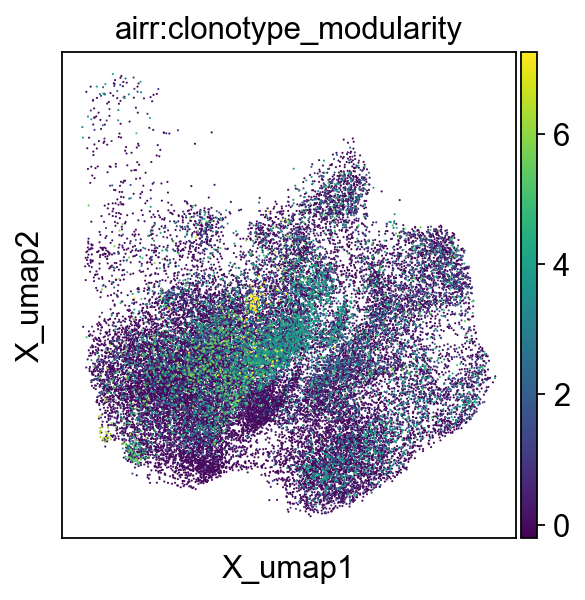

In [13]:
mu.pl.embedding(mdata_T, basis="gex:umap", color="airr:clonotype_modularity")

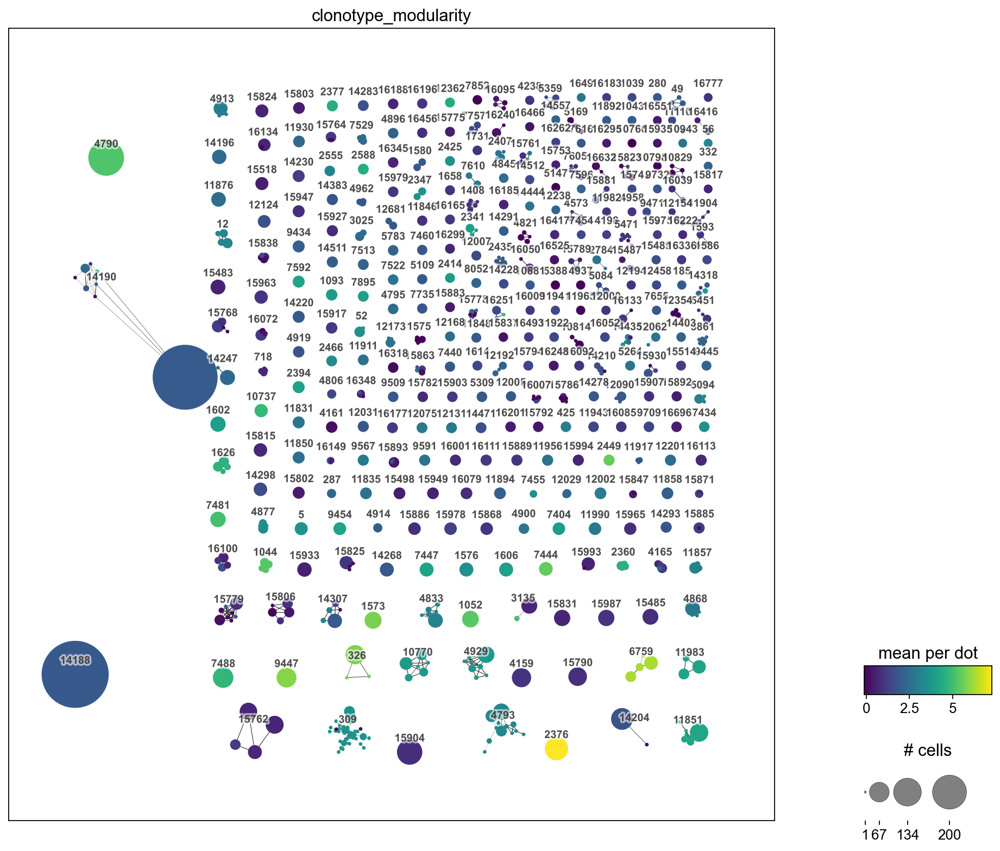

In [16]:
ir.pl.clonotype_network(
    mdata_T,
    color="clonotype_modularity",
    label_fontsize=9,
    panel_size=(12, 12),
    base_size=4,
).figure.savefig(f"{figPath}/T_clonotype_modularity.png", dpi=300)

In [20]:
clonotypes_top_modularity = list(
    mdata_T.obs.set_index("airr:cc_aa_alignment")["airr:clonotype_modularity"]
    .sort_values(ascending=False)
    .index.unique()
    .values[:10]
)
clonotypes_top_modularity.extend(["309", "3135"])


/home/rzh/BCY/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


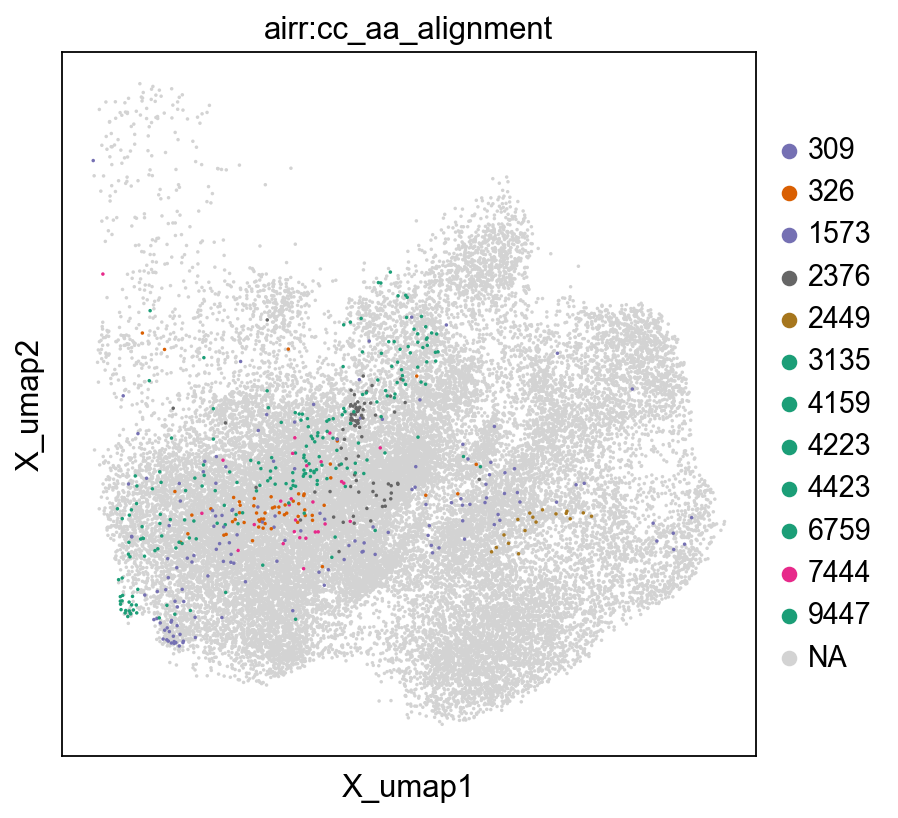

In [22]:
from cycler import cycler
from matplotlib import cm as mpl_cm
fig, ax = plt.subplots(figsize=(5.5, 5), constrained_layout=True)
test_ad = mu.pl.embedding(
    mdata_T,
    basis="gex:umap",
    color="airr:cc_aa_alignment",
    groups=clonotypes_top_modularity,
    palette=cycler(color=mpl_cm.Dark2_r.colors),
    ax=ax, 
    size=10,
)
fig.savefig(f"{figPath}/T-airr.png", dpi=300, bbox_inches="tight")

In [26]:
mbcy_T = mdata_T.copy()
mu.pp.filter_obs(mbcy_T, var="gex:batch", func=lambda x: x=="Young")
mbcy_T

MuData object with n_obs × n_vars = 22258 × 19885
  uns:	'clonotype_modularity'
  2 modalities
    gex:	22258 x 19885
      obs:	'batch', 'mt_frac', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'n_genes', 'n_counts', 'leiden', 'major_type', 'molecular_type', 'leiden_harmony', 'major_type_harmony', 'leiden-T', 'T-type', 'T-subtype', 'sample', 'major-type', 'minor_type', 'minor-type', 'gender', 'doublet_score', 'predicted_doublet', 'leiden-harmony-female', 'majorType-Female', 'epi-subtype', 'majorType-fix', 'leiden-major', 'leiden-gex'
      var:	'n_cells_by_counts-Middle-Middle', 'mean_counts-Middle-Middle', 'log1p_mean_counts-Middle-Middle', 'pct_dropout_by_counts-Middle-Middle', 'total_counts-Middle-Middle', 'log1p_total_counts-Middle-Middle', 'n_cells-Middle-Middle', 'highly_variable-Middle-Middle', 'means-Middle-Middle', 'dispersions-Middle-Middle', 'dispersions_norm-Middle-Middle', 'ID-Middle-Middle', 'name-Middle-Middle', 'type-Middle-Middle', 'n_cells_by_counts-Young-Middle', 'mean_counts-Young-Middle', 'log1p_mean_counts-Young-Middle', 'pct_dropout_by_counts-Young-Middle', 'total_counts-Young-Middle', 'log1p_total_counts-Young-Middle', 'n_cells-Young-Middle', 'highly_variable-Young-Middle', 'means-Young-Middle', 'dispersions-Young-Middle', 'dispersions_norm-Young-Middle', 'n_cells_by_counts-Young', 'mean_counts-Young', 'log1p_mean_counts-Young', 'pct_dropout_by_counts-Young', 'total_counts-Young', 'log1p_total_counts-Young', 'n_cells-Young', 'highly_variable-Young', 'means-Young', 'dispersions-Young', 'dispersions_norm-Young'
      uns:	'airr:chain_pairing_colors', 'airr:receptor_subtype_colors', 'airr:receptor_type_colors', 'batch_colors', 'dendrogram_leiden-gex', 'gex:T-subtype_colors', 'leiden', 'leiden-gex_colors', 'neighbors', 'pca', 'rank_genes_groups', 'umap', 'airr:cc_aa_alignment_colors'
      obsm:	'X_pca', 'X_pca_harmony', 'X_umap'
      varm:	'PCs'
      obsp:	'connectivities', 'distances'
    airr:	22258 x 0
      obs:	'chain_pairing', 'clonal_expansion', 'clone_id', 'clone_id_size', 'clonotype_modularity', 'receptor_subtype', 'receptor_type', 'cc_aa_alignment', 'cc_aa_alignment_size', 'cc_aa_alignment_same_v', 'cc_aa_alignment_same_v_size', 'clonotype_modularity_fdr'
      uns:	'cc_aa_alignment', 'chain_indices', 'clone_id', 'clonotype_network', 'ir_dist_aa_alignment', 'ir_dist_aa_identity', 'ir_dist_nt_identity', 'scirpy_version', 'cc_aa_alignment_same_v', 'repertoire_overlap'
      obsm:	'X_clonotype_network', 'airr', 'chain_indices'

In [28]:
bcy_T = sc.read_h5ad("adata-T.h5ad")


In [29]:
preDict = ['1T','2T','3T','5N','5T','6N',
           '6T','8T','9T','10N','10T','12N','15T','16N',
           '17T','20T','21T','22T',
           ]
bcy_T = bcy_T[bcy_T.obs['batch'].isin(preDict), :]
bcy_T.obs['sample']=bcy_T.obs['batch']
bcy_T.obs['major-type']="T cells"

/tmp/ipykernel_1729537/3108935105.py:6: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  bcy_T.obs['sample']=bcy_T.obs['batch']


In [30]:
mbcy_T.obs['gex:T-subtype'] = bcy_T.obs['T-subtype']

/home/rzh/BCY/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


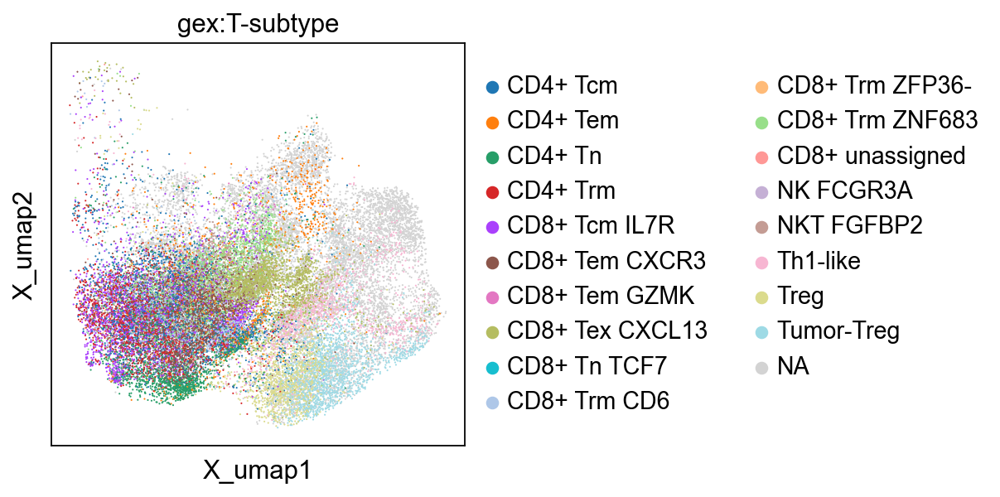

In [174]:
fig, ax=plt.subplots(1, 1, figsize=(4, 4))
mu.pl.embedding(mdata_T, basis="gex:umap", color="gex:T-subtype", ax=ax)
fig.savefig(f"{figPath}/umap_T-subtype.png", dpi=300, bbox_inches="tight")

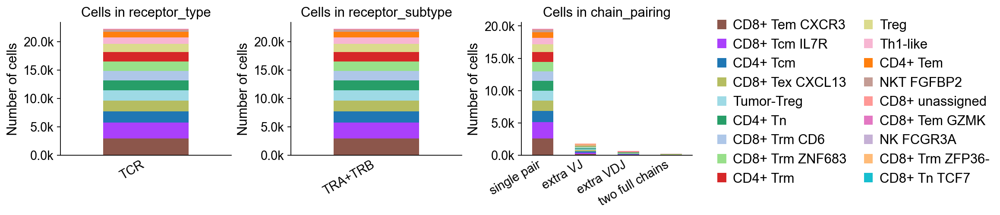

In [44]:
# abundance of TCR,BCR targeting major_type
def ks(x, pos):
    return '%1.1fk' % (x*1e-3)
fig, ax = plt.subplots(1, 3,figsize=(13,3), constrained_layout=True)
for i,g in enumerate(["airr:receptor_type", "airr:receptor_subtype", 'airr:chain_pairing']):
  ir.pl.group_abundance(mbcy_T, groupby=g, 
                        target_col="gex:T-subtype", 
                        ax=ax[i], 
                        style_kws={"title": "Cells in {}".format(g.split(":")[1]),
                                   "xlab": '',
                                   "title_fontsize":14, 
                                   "label_fontsize":14, 
                                   "tick_fontsize":13,
                                   "add_legend": True})
  ax[i].yaxis.set_major_formatter(FuncFormatter(ks))
ax[0].legend_.remove()
ax[1].legend_.remove()
ax[2].legend(fontsize=14,
      frameon=False, handletextpad=0.5, loc="right",bbox_to_anchor=(2.8,0.4),ncols=2,
              borderpad=0.3,
              columnspacing=1.3,
              handlelength=0.65,)
fig.savefig(f"{figPath}/bcy-abundance-tbcr-T.png", dpi=300, bbox_inches='tight')

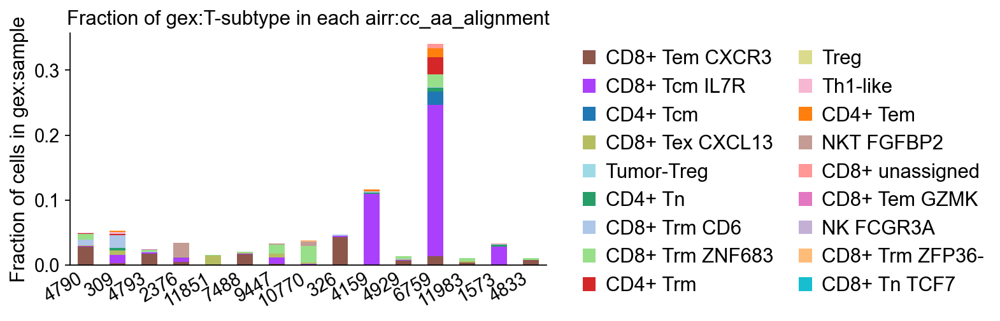

In [159]:
ax = ir.pl.group_abundance(mbcy_T, groupby="airr:cc_aa_alignment", 
                      target_col="gex:T-subtype", 
                      max_cols=15,
                      fig_kws={"figsize":(6,3)},
                      normalize="gex:sample",
                      style_kws={
                                  "xlab": '',
                                  "title_fontsize":14, 
                                  "label_fontsize":14, 
                                  "tick_fontsize":13,
                                  "add_legend": True})
ax.legend(fontsize=14,
      frameon=False, handletextpad=0.5, loc="right",bbox_to_anchor=(1.95,0.4),ncols=2,
              borderpad=0.3,
              columnspacing=1.3,
              handlelength=0.65,)
ax.figure.savefig(f"{figPath}/abundance_alignment_cluster.svg", bbox_inches="tight")

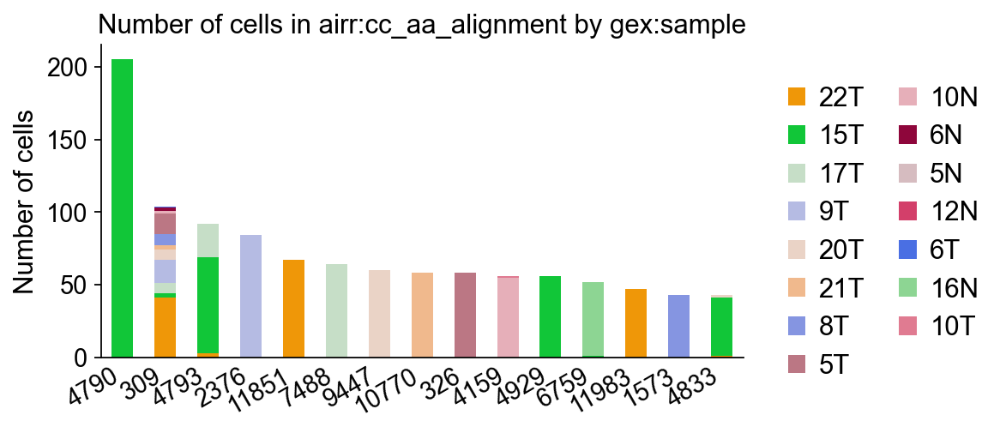

In [156]:
ax = ir.pl.group_abundance(mbcy_T, groupby="airr:cc_aa_alignment", 
                      target_col="gex:sample", 
                      max_cols=15,
                      fig_kws={"figsize":(6,3)},
                      style_kws={
                                  "xlab": '',
                                  "title_fontsize":14, 
                                  "label_fontsize":14, 
                                  "tick_fontsize":13,
                                  "add_legend": True})
ax.legend(fontsize=14,
      frameon=False, handletextpad=0.5, loc="right",bbox_to_anchor=(1.4,0.4),ncols=2,
              borderpad=0.3,
              columnspacing=1.3,
              handlelength=0.65,)
ax.figure.savefig(f"{figPath}/abundance_alignment_sample.svg", bbox_inches="tight",)

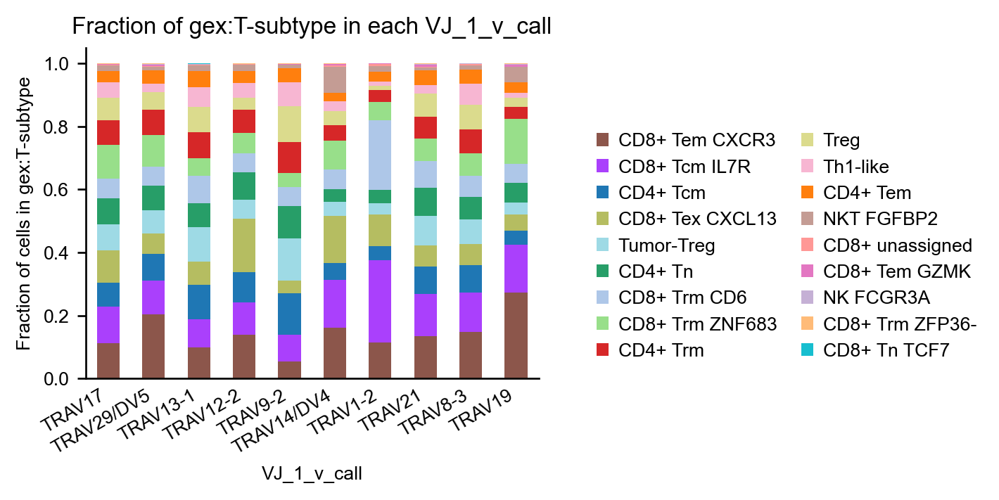

In [149]:
with ir.get.airr_context(mbcy_T, "v_call"):
    ax=ir.pl.group_abundance(
        mbcy_T,
        groupby="VJ_1_v_call",
        target_col="gex:T-subtype",
        normalize=True,
        max_cols=10,
    )
    ax.legend(fontsize=8,
      frameon=False, handletextpad=0.5, loc="right",bbox_to_anchor=(2,0.4),ncols=2,
              borderpad=0.3,
              columnspacing=1.3,
              handlelength=0.65,)
    ax.figure.savefig(f"{figPath}/abundance_VJ_T-subtype.svg", bbox_inches="tight",)

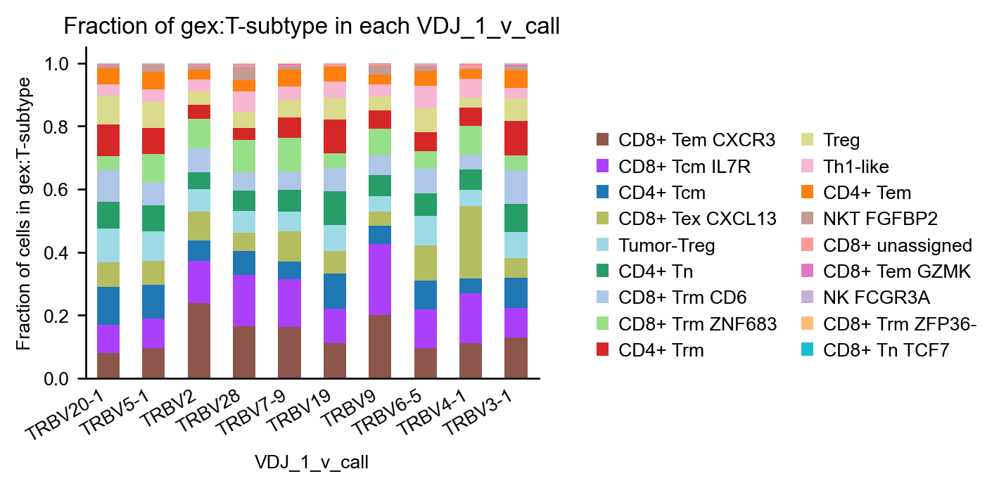

In [148]:
with ir.get.airr_context(mbcy_T, "v_call"):
    ax=ir.pl.group_abundance(
        mbcy_T,
        groupby="VDJ_1_v_call",
        target_col="gex:T-subtype",
        normalize=True,
        max_cols=10,
    )
    ax.legend(fontsize=8,
      frameon=False, handletextpad=0.5, loc="right",bbox_to_anchor=(2,0.4),ncols=2,
              borderpad=0.3,
              columnspacing=1.3,
              handlelength=0.65,)
    ax.figure.savefig(f"{figPath}/abundance_VDJ_T-subtype.svg", bbox_inches="tight",)

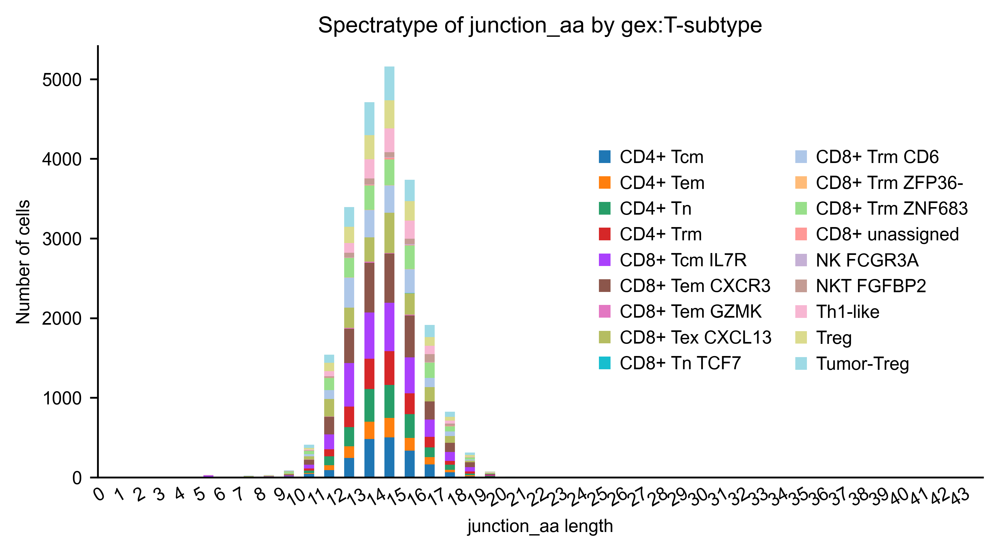

In [147]:
ax = ir.pl.spectratype(mbcy_T, color="gex:T-subtype", viztype="bar", fig_kws={"dpi": 300, "figsize":(7,3.5)})
ax.legend(fontsize=8,
  frameon=False, handletextpad=0.5, loc="right",bbox_to_anchor=(1,0.5),ncols=2,
          borderpad=0.3,
          columnspacing=1.3,
          handlelength=0.65,)
ax.figure.savefig(f"{figPath}/spectratype_aa_T-subtype.png", bbox_inches="tight", dpi=300)

/home/rzh/BCY/lib/python3.10/site-packages/scirpy/pl/base.py:261: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_yticklabels(order)


<AxesSubplot: title={'center': 'Spectratype of junction_aa by gex:T-subtype'}, xlabel='junction_aa length'>

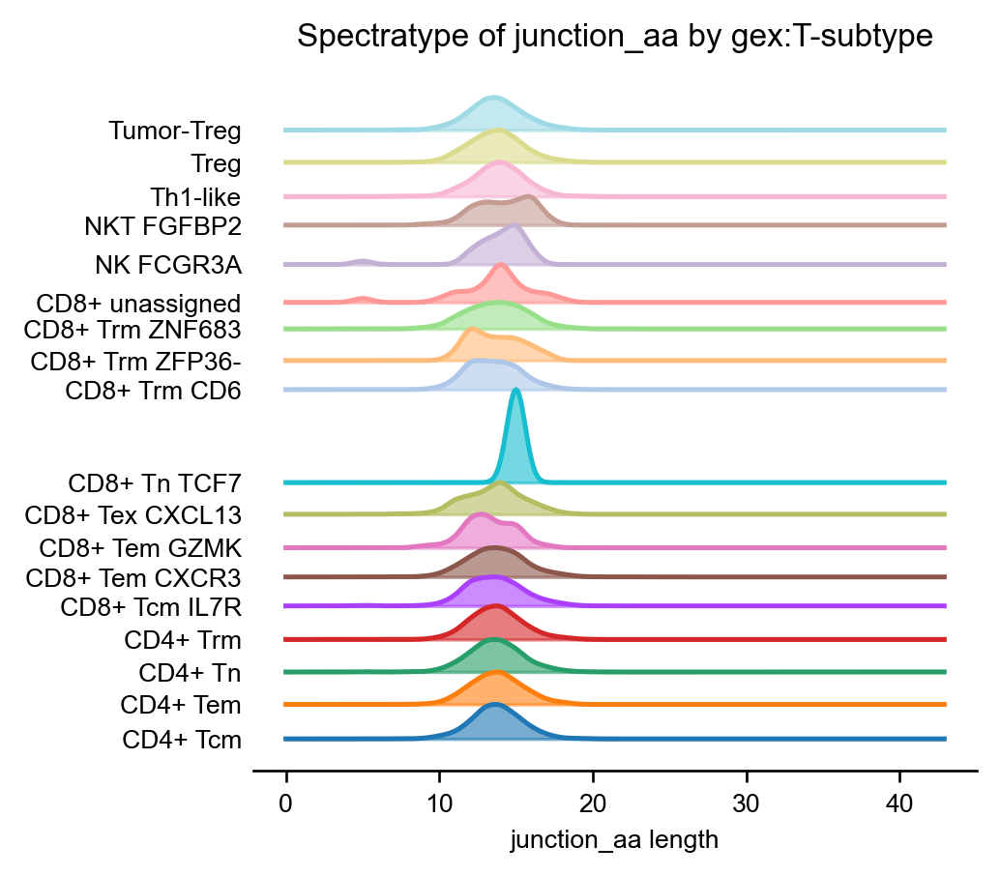

In [69]:
ir.pl.spectratype(
    mbcy_T,
    color="gex:T-subtype",
    viztype="curve",
    curve_layout="shifted",
    fig_kws={"dpi": 120},
    kde_kws={"kde_norm": False},
)

In [78]:
print("Number of NK cells with TCRs: {:.2f}".format(
  np.sum(mbcy_T.obs['gex:T-subtype'] == 'NKT FGFBP2')
))

Number of NK cells with TCRs: 413.00


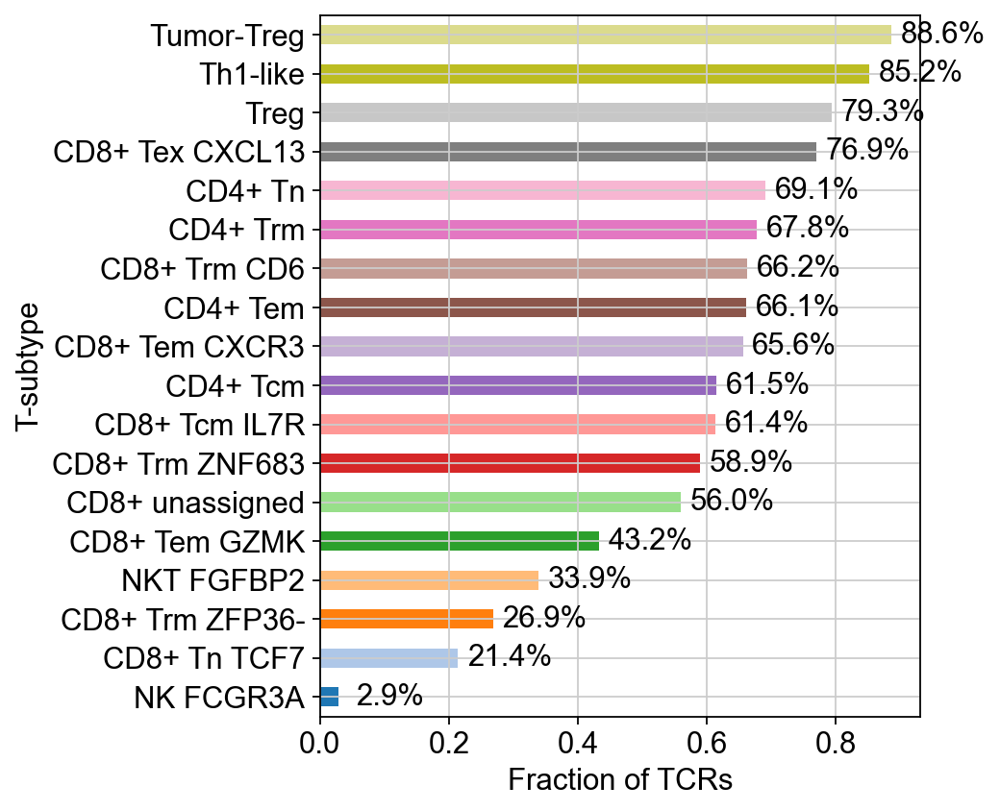

In [186]:
import matplotlib.cm as cm
from collections import Counter
colors = cm.get_cmap('tab20')(np.arange(20))

# the fraction of tcrs in T subtypes
cells = Counter(bcy_T.obs['T-subtype'][bcy_T.obs['technique'] == '5\''])
tcrs = Counter(mbcy_T.obs['gex:T-subtype'])
frac = pd.Series(index=cells.keys(), data=[tcrs[cell] / cells[cell] for cell in cells])
ax = frac.sort_values().plot(kind='barh',color=colors, figsize=(5,6))
ax.set_xlabel('Fraction of TCRs')
ax.set_ylabel('T-subtype')
for i, value in enumerate(frac.sort_values()):  
    # 将百分比转换为字符串并格式化为带有两位小数的格式  
    percentage_str = "{:.1f}%".format(value*100)  
    # 在条形图的顶部居中放置文本  
    ax.text(value+0.08,i, percentage_str, ha='center', va='center')
ax.figure.savefig(f"{figPath}/frac.svg",bbox_inches='tight')


In [106]:
np.array([[tcrs[cell] / cells[cell] for cell in cells], colors])

/tmp/ipykernel_1729537/1609272528.py:1: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  np.array([[tcrs[cell] / cells[cell] for cell in cells], colors])


array([list([0.56, 0.8517682468021068, 0.6148031496062992, 0.6137246439361242, 0.6775911511675543, 0.6911412609736632, 0.6623427672955975, 0.33852459016393444, 0.6560609455523191, 0.7931422147273749, 0.6613011401743796, 0.5894996476391825, 0.8863294942413621, 0.4322033898305085, 0.028907922912205567, 0.26865671641791045, 0.7691377921031426, 0.21428571428571427]),
       array([[0.12156863, 0.46666667, 0.70588235, 1.        ],
              [0.68235294, 0.78039216, 0.90980392, 1.        ],
              [1.        , 0.49803922, 0.05490196, 1.        ],
              [1.        , 0.73333333, 0.47058824, 1.        ],
              [0.17254902, 0.62745098, 0.17254902, 1.        ],
              [0.59607843, 0.8745098 , 0.54117647, 1.        ],
              [0.83921569, 0.15294118, 0.15686275, 1.        ],
              [1.        , 0.59607843, 0.58823529, 1.        ],
              [0.58039216, 0.40392157, 0.74117647, 1.        ],
              [0.77254902, 0.69019608, 0.83529412, 1.     

array([[0.12156863, 0.46666667, 0.70588235, 1.        ],
       [0.68235294, 0.78039216, 0.90980392, 1.        ],
       [1.        , 0.49803922, 0.05490196, 1.        ],
       [1.        , 0.73333333, 0.47058824, 1.        ],
       [0.17254902, 0.62745098, 0.17254902, 1.        ],
       [0.59607843, 0.8745098 , 0.54117647, 1.        ],
       [0.83921569, 0.15294118, 0.15686275, 1.        ],
       [1.        , 0.59607843, 0.58823529, 1.        ],
       [0.58039216, 0.40392157, 0.74117647, 1.        ],
       [0.77254902, 0.69019608, 0.83529412, 1.        ],
       [0.54901961, 0.3372549 , 0.29411765, 1.        ],
       [0.76862745, 0.61176471, 0.58039216, 1.        ],
       [0.89019608, 0.46666667, 0.76078431, 1.        ],
       [0.96862745, 0.71372549, 0.82352941, 1.        ],
       [0.49803922, 0.49803922, 0.49803922, 1.        ],
       [0.78039216, 0.78039216, 0.78039216, 1.        ],
       [0.7372549 , 0.74117647, 0.13333333, 1.        ],
       [0.85882353, 0.85882353,

In [83]:
bcy_T.obs['technique'] = '5\''
bcy_T.obs.loc[bcy_T.obs['sample'].isin(['1T', '2T', '3T']),'technique'] = '3\''

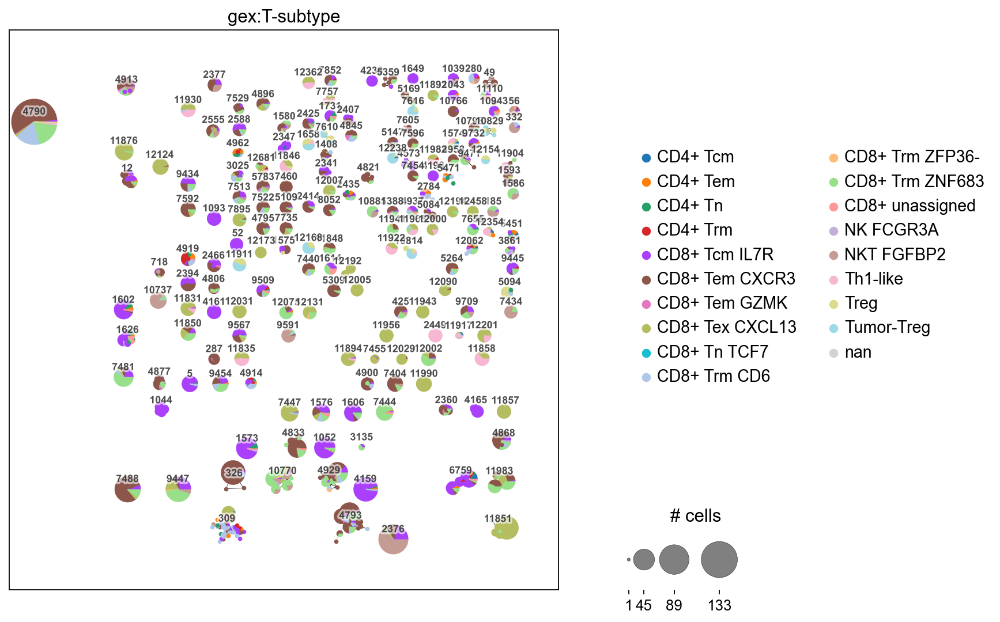

In [192]:
ax = ir.pl.clonotype_network(mbcy_T, color="gex:T-subtype", label_fontsize=8, panel_size=(8,8), base_size=6)
ax.figure.savefig(f"{figPath}/clono_netcluster_T-subtype.svg")

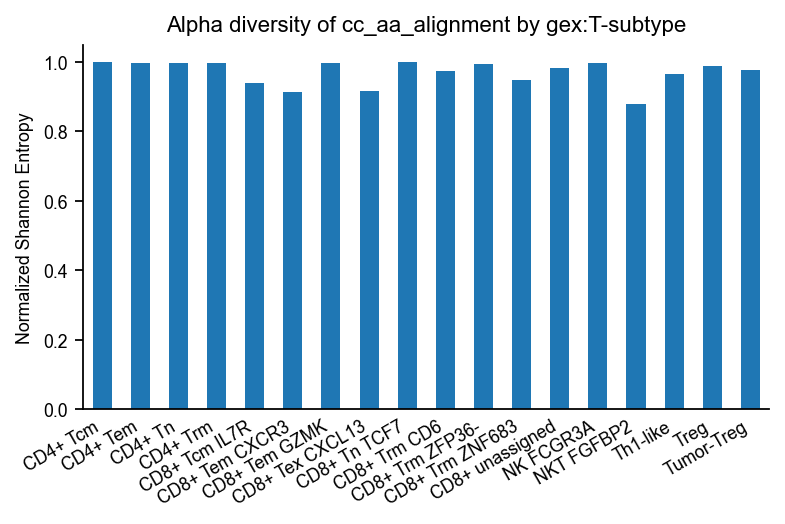

In [205]:
ax = ir.pl.alpha_diversity(mbcy_T, metric="normalized_shannon_entropy", groupby="gex:T-subtype",fig_kws={"figsize":(5.5,3)}, target_col="cc_aa_alignment")
ax.figure.savefig(f"{figPath}/alpha_T-subtype.svg", bbox_inches="tight")

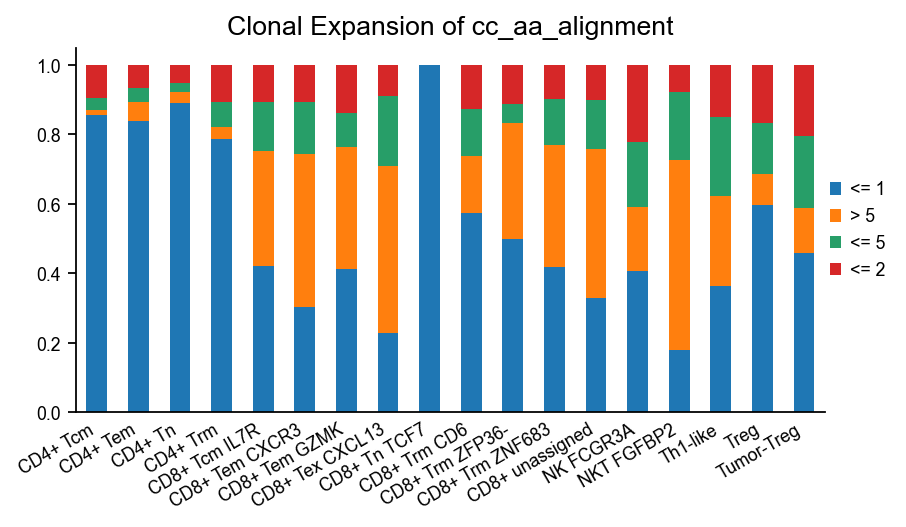

In [209]:
ax = ir.pl.clonal_expansion(mbcy_T, target_col="cc_aa_alignment", groupby="gex:T-subtype", breakpoints=(1, 2, 5), normalize=True,fig_kws={"figsize":(6,3)})
ax.legend(fontsize=8,
  frameon=False, handletextpad=0.5, loc="right",bbox_to_anchor=(1.1,0.5),ncols=1,
          borderpad=0.3,
          columnspacing=1.3,
          handlelength=0.65,)
ax.set_title("Clonal Expansion of cc_aa_alignment", fontsize=12)
ax.figure.savefig(f"{figPath}/clonal_expension_T-subtype.svg", bbox_inches="tight")

In [219]:
import celltypist